# Volatility Capital: Quantitative Trading Strategy Proposal

- Aryamaan Jena - 12334126
- William Labasi-Sammartino - 12332761
- Som Mookherji - 12334609


This file is meant to complement the slides. In particular, it provides more details on certain aspects of the trading strategy. It is broken into three parts:

 - Data Exploration: Examines the statistical and descriptive properties of the data used in the trading strategy.
 
 - Realized Volatility Modeling: Trains and assesses the performance of an ensemble of machine learning models for fitting and forecasting realized volatility.
 
 - Volatilty Cones: Discusses how the cones are constructed and how the trading strategy makes use of them.

## Exploratory Data Analysis - Futures

### 1. Prerequisites and Data

In [2]:
# command to install plotly for interactive plots
!pip install plotly

In [2]:
# importing libraries

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

import scipy as sp
import seaborn as sns
import matplotlib.cm as cm

from sklearn.model_selection import train_test_split
import statsmodels.api as sm

import pandas_datareader as data
import quandl

import functools
import datetime as dt
import warnings

import plotly.express as px
import kaleido

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import arch
sns.set()


# configuring
warnings.filterwarnings('ignore')
pd.options.display.max_rows = 65
pd.set_option('use_inf_as_na', True)

sns.set()
color = sns.color_palette()
%matplotlib inline

In [3]:
# read data
path = r'/Users/aryamaan/Desktop/QTS/project_data/Microchip.gz'
data = pd.read_csv(path, compression='gzip', 
                                 header=0, sep=',', quotechar='"')

In [4]:
# inspect data
data.head()

,secid,date,days,forward_price,strike_price,premium,impl_volatility,delta,gamma,theta,vega,cp_flag,cusip,ticker,sic,index_flag,exchange_d,class,issue_type,industry_group
0,101121,20060905,10,26.258663,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,C,790310,AMD,3674,0,5,NaN,0,NaN
1,101121,20060905,30,26.336830,26.336830,1.517095,0.506302,0.528917,0.104509,-9.877017,2.991241,C,790310,AMD,3674,0,5,NaN,0,NaN
2,101121,20060905,60,26.455649,26.455649,2.149217,0.507633,0.540966,0.073510,-7.166544,4.219057,C,790310,AMD,3674,0,5,NaN,0,NaN
3,101121,20060905,91,26.578851,26.578851,2.432684,0.466801,0.546370,0.064815,-5.503267,5.188162,C,790310,AMD,3674,0,5,NaN,0,NaN
4,101121,20060905,122,26.702089,26.702089,2.813964,0.466704,0.553639,0.055860,-4.820254,5.993364,C,790310,AMD,3674,0,5,NaN,0,NaN


In [5]:
# inspect data
data.columns

Index(['secid', 'date', 'days', 'forward_price', 'strike_price', 'premium',
       'impl_volatility', 'delta', 'gamma', 'theta', 'vega', 'cp_flag',
       'cusip', 'ticker', 'sic', 'index_flag', 'exchange_d', 'class',
       'issue_type', 'industry_group'],
      dtype='object')

In [6]:
# inspect data
data.shape

(831818, 20)

### 2. Data Wrangling

#### 2.1 For Volatility Inspection

In [7]:
# convert date to datetime data type
data['date'] = pd.to_datetime(data['date'], format='%Y%m%d')

In [8]:
def ticker_option_type_data(data):
    """
    input: raw dataset 
    action: filter by ticker
    output: dictionary of dataframes
    eg.- {'NVDA_calls': <dataframe of NVDA Calls>}
    """
    
    return_dict = {}
    
    for ticker in data.ticker.unique():
        df = data[data['ticker'] == ticker].drop(columns=['secid', 'ticker', 'cusip', 
                        'sic', 'index_flag', 'exchange_d', 'class', 'issue_type', 'industry_group'])
        df = df[df.days != 10].dropna()

        df_calls = df[df.cp_flag == 'C'].drop(columns=['cp_flag'])
        df_puts = df[df.cp_flag == 'P'].drop(columns=['cp_flag'])
        return_dict[ticker+'_calls'] = df_calls
        return_dict[ticker+'_puts'] = df_puts
        
    return return_dict

data_dict = ticker_option_type_data(data)

In [9]:
data_dict['NVDA_calls']

,date,days,forward_price,strike_price,premium,impl_volatility,delta,gamma,theta,vega
435947,2006-09-05,30,28.626991,28.626991,1.626214,0.499289,0.528517,0.097506,-10.598575,3.251585
435948,2006-09-05,60,28.756141,28.756141,2.288627,0.497281,0.540133,0.069052,-7.648175,4.586913
435949,2006-09-05,91,28.890057,28.890057,2.756284,0.486678,0.548335,0.057160,-6.200188,5.635983
435950,2006-09-05,122,29.024011,29.024011,3.152105,0.481053,0.555277,0.049830,-5.373945,6.510838
435951,2006-09-05,152,29.152983,29.152983,3.476606,0.475677,0.560969,0.045052,-4.820561,7.252073
...,...,...,...,...,...,...,...,...,...,...
508574,2020-12-31,182,522.323930,522.323930,61.232512,0.417870,0.558493,0.002560,-61.348259,145.444778
508575,2020-12-31,273,522.382520,522.382520,75.078901,0.419193,0.571631,0.002072,-50.012779,177.116940
508576,2020-12-31,365,522.458102,522.458102,86.901624,0.420530,0.582804,0.001775,-43.180206,203.589852
508577,2020-12-31,547,522.649041,522.649041,106.919407,0.424513,0.601682,0.001419,-35.243848,246.206656


#### 2.1 For Autocorrelation Inspection

In [10]:
# divide calls and puts
df = data.copy()
df.date=pd.to_datetime(df.date,format="%Y%m%d")
df.set_index('date',inplace=True)
call=df[df.cp_flag=="C"]
put=df[df.cp_flag=="P"]

In [11]:
# create future prices
def make_forwards(df,window):
    df=df[df.days==window]
    temp=df.groupby(['ticker','date']).forward_price.first().reset_index()
    futures=pd.DataFrame(index=df.index.unique())
    for i in df.ticker.unique():
        futures=futures.join(temp.groupby('ticker').get_group(i).set_index('date').forward_price.to_frame(i))
    return futures

In [12]:
# inspect data
forwards=make_forwards(df,30).fillna(0) # taking only 30 day forwards
forward_returns = forwards.pct_change()
forward_returns[['AMD']]

,AMD
date,
2006-09-05,NaN
2006-09-06,-0.064453
2006-09-07,0.002448
2006-09-08,0.049209
2006-09-11,-0.005418
...,...
2020-12-24,0.002837
2020-12-28,-0.002287
2020-12-29,-0.010698


### 3. Visualization

#### 3.1 Inspecting Implied Volatilities

We construct interactive plots for implied volatility to inspect the data for abnormalities, outliers and inconsistencies. By hovering over the plot, we are able to look at the individual data points underlying the plot aspect.

In [13]:
def create_faceted_line_plot(name, df):
    """
    input: name of ticker_optionType, data associated to the ticker-option type pair 
    action: create a line plot of implied volatilities faceted by days to expiry
    output: figure
    """
    
    fig = px.line(df, x='date', y='impl_volatility', facet_col="days", color='days', 
              facet_col_wrap=2,width=800, height=800,
             labels={
                     "impl_volatility": "Implied Volatility",
                     "days": "Days to Expiry",
                 })

    fig.update_layout(
        title="At-the-money Implied Volatility by Days to Expiry - "+name,
        legend_title="Days to Expiry")

    fig.show()

In [14]:
for key in ['AMD_calls', 'AMD_puts', 'INTC_calls', 'INTC_puts', 'NVDA_calls', 'NVDA_puts']:
    create_faceted_line_plot(key,data_dict[key])

#### Note: Attaching Static Images of Plots created above in-case interactive plots do not render

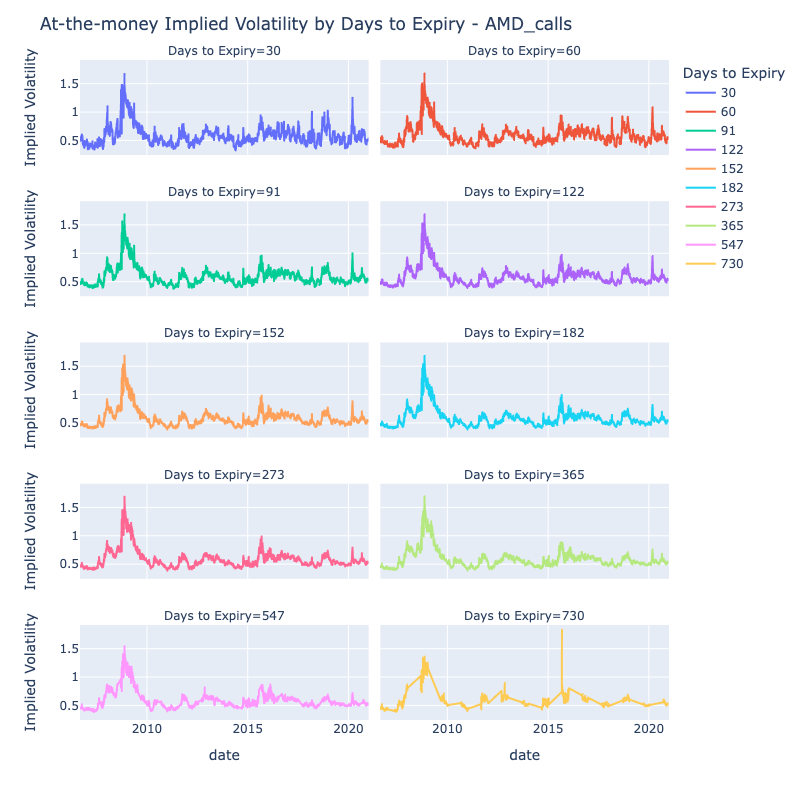

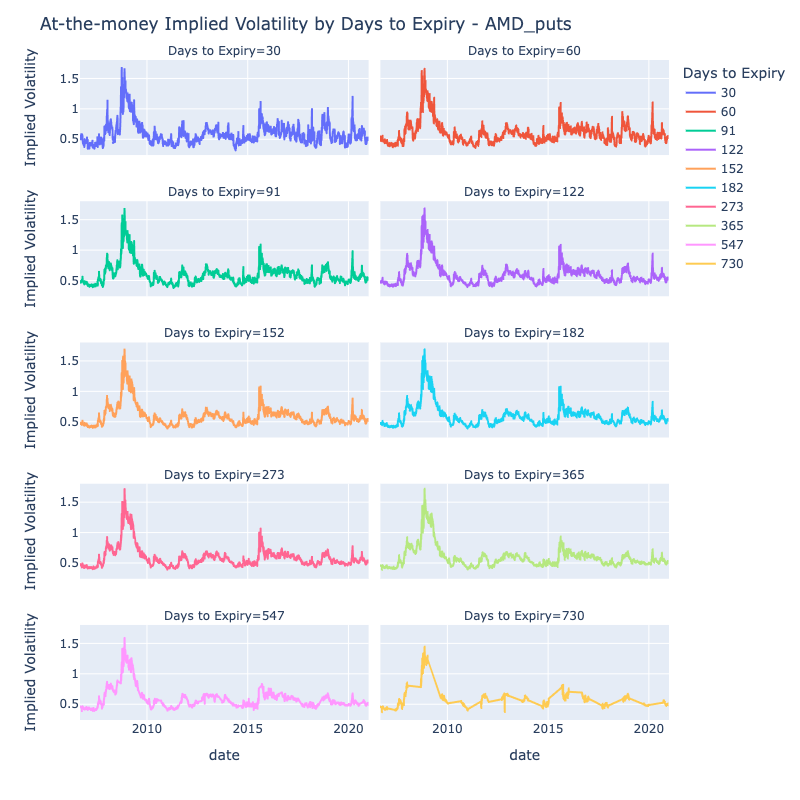

#### 3.2 Autocorrelation Analysis

#### 3.2.1 Autocorrelation

We inspect the Autocorrelation plots for our entire asset universe to determine degree of autocorrelation

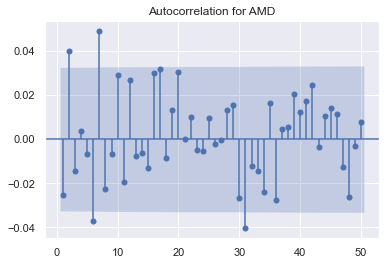

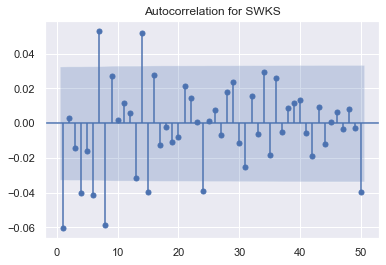

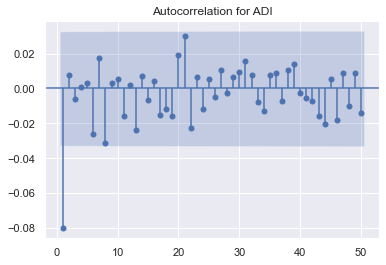

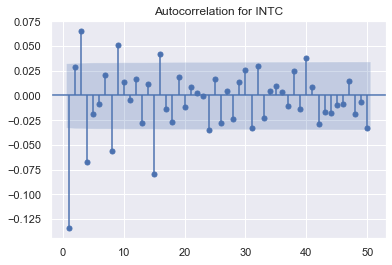

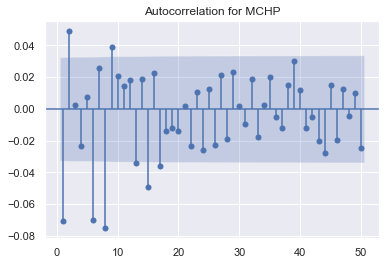

...

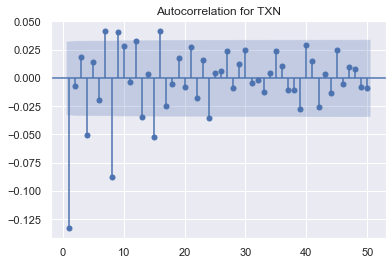

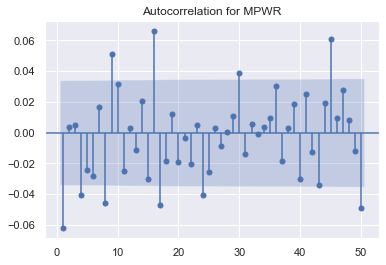

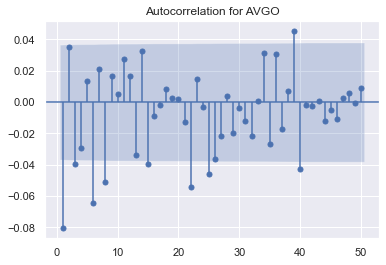

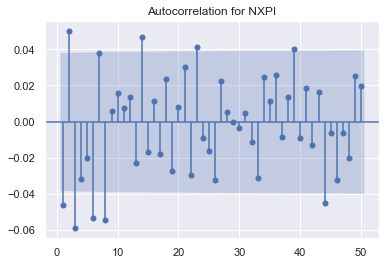

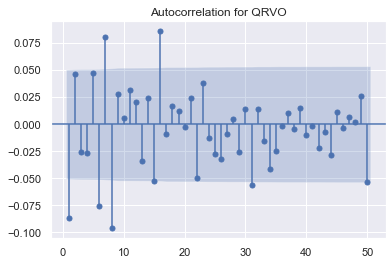

In [15]:
for i, tkr in enumerate(forward_returns.columns):
    x = plot_acf(forward_returns[[f'{tkr}']].dropna(), lags=50, zero = False,
                 title = f'Autocorrelation for {tkr}')
    plt.show()

From empirical analysis of the Autocorrelation, we cannot see significant autocorrelation for a univariate GARCH model for volatility. However, we also look at the partial autocorrelation

#### 3.2.1 Partial Autocorrelation

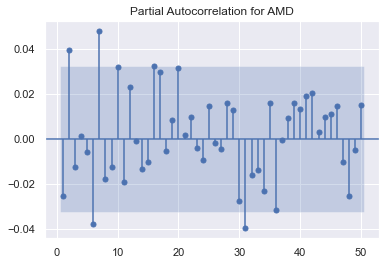

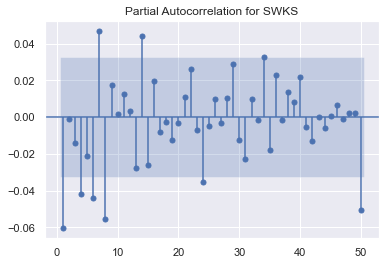

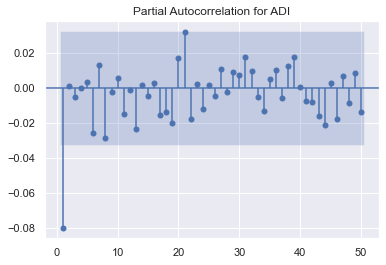

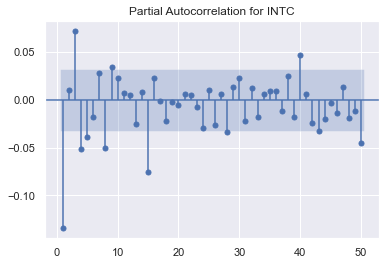

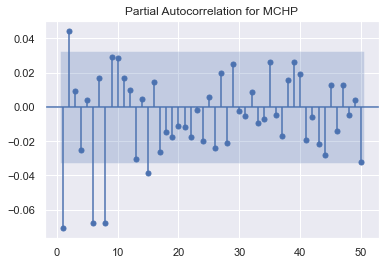

...

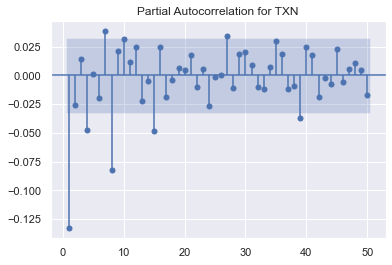

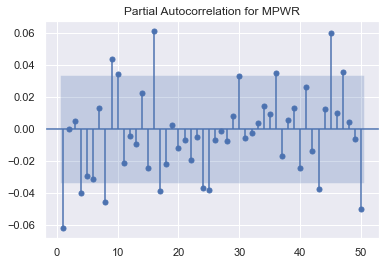

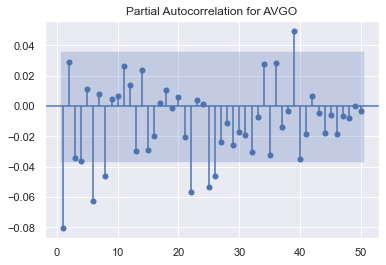

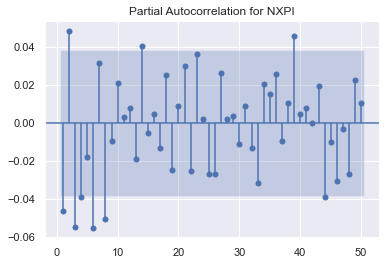

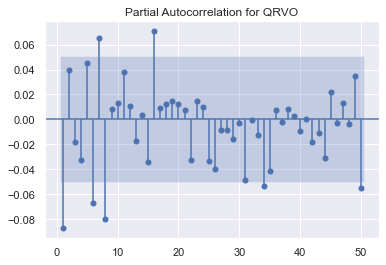

In [16]:
for i, tkr in enumerate(forward_returns.columns):
    x = plot_pacf(forward_returns[[f'{tkr}']].dropna(), lags=50, zero = False,
                 title = f'Partial Autocorrelation for {tkr}')
    plt.show()

From the partial autocorrelation plots, we see that we do not find significant enough autocorrelation for univariate volatility models. We thus move our attention to multivariate realized volatility models.

In [130]:
import pandas as pd
import matplotlib as plt 
import numpy as np
import json
from datetime import date
import numpy as np
from scipy.spatial import ConvexHull
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
from pandas.plotting import lag_plot
#Libraries
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import scipy as sp
import quandl
import functools
import seaborn as sns
#!pip install plotnine
import plotnine as p9
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import display, HTML
import requests
import quandl
import functools
#from fenics import *
import re
import calendar
import optuna
from optuna.trial import Trial
optuna.logging.set_verbosity(optuna.logging.FATAL)
import warnings
warnings.filterwarnings("ignore")
from functools import partial
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.datasets import make_regression
from sklearn.model_selection import train_test_split
#import nasdaqdatalink
CSS = """
.output {
    flex-direction: row;
}
"""
import statsmodels
import statsmodels.formula.api as sm
HTML('<style>{}</style>'.format(CSS))
import numpy as np
import pandas as pd
from statsmodels.tsa.stattools import adfuller

import matplotlib.pyplot as plt
from matplotlib import rcParams
from cycler import cycler
from statsmodels.tsa.stattools import adfuller
import statsmodels.formula.api as sm
#Libraries
import matplotlib.pyplot as plt
import statsmodels.api as sm
import pandas as pd
import numpy as np
import scipy as sp
import quandl
import functools
import seaborn as sns
#!pip install plotnine
import plotnine as p9
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import display, HTML
import requests
import quandl
import functools
import re
import calendar
#import statsmodels as sm
#import nasdaqdatalink
CSS = """
.output {
    flex-direction: row;
}
"""
import pylab as pl
import warnings
warnings.filterwarnings('ignore')
HTML('<style>{}</style>'.format(CSS))
import numpy as np
import pandas as pd
from statsmodels.tsa.stattools import adfuller

import matplotlib.pyplot as plt
from matplotlib import rcParams
from cycler import cycler
from statsmodels.tsa.stattools import adfuller

    
def display_corr(df,list_maxmin=True):
    
    corrmat = df.corr()
    #ignore self-correlation
    corrmat[corrmat==1] = None
    sns.heatmap(corrmat)

    if list_maxmin:
        corr_rank = corrmat.unstack().sort_values().dropna()
        pair_max = corr_rank.index[-1]
        pair_min = corr_rank.index[0]

        print(f'MIN Correlation pair is {pair_min}')
        print(f'MAX Correlation pair is {pair_max}')
        
#Functions
#XBI-PBE
def rr(data, maxDD = False):

    data_desc = data.describe().loc[['mean','std']]

    # data_desc.loc['Mean'] = data_desc.loc['mean'] # Unannualize
    # data_desc.loc['Standard Deviation'] = data_desc.loc['std']# Unannualize
    data_desc=data_desc.rename(columns={'mean':'Mean','std':'Standard Deviation'})
   # report['Max']=df.max()
    #report['Min']=df.min()
    data_desc.loc['Sharpe'] = data_desc.loc['mean'] / data_desc.loc['std']
    data_desc.loc['Minimum'] = np.min(data)
    data_desc.loc['Maximum'] = np.max(data)
    data_desc.loc['Median'] = data.median()
    data_desc.loc['Skewness'] = data.skew()
    data_desc.loc['Excess Kurtosis'] = data.kurt()
    data_desc.loc['5 %ile'] = data.quantile(0.05)
    data_desc.loc['10 %ile'] = data.quantile(0.10)
    data_desc.loc['90 %ile'] = data.quantile(0.90)
    data_desc.loc['95 %ile'] = data.quantile(0.95)
    data_desc.loc['Expected Value 5 %ile'] = data[data < data.quantile(0.05)].mean()
    data_desc.loc['Expected Value 10 %ile'] = data[data < data.quantile(0.10)].mean()
    data_desc.loc['Expected Value 90 %ile'] = data[data < data.quantile(0.90)].mean()
    data_desc.loc['Expected Value 95 %ile'] = data[data < data.quantile(0.95)].mean()
  
    def getMaxDDInfo(data):
        cumRet = (1+data).cumprod()
        cumMax = cumRet.cummax()
        dd = (cumRet/cumMax)-1
        # print(dd.min())
        
        maxDD = pd.DataFrame([tuple(dd.min())],
                            columns=data.columns,
                            index=['maxDrawdown'])

        maxDD_dt = []
        # loop through each column in dd (drawdown DataFrame)
        for col,val in dd.iteritems():
            mdd = maxDD[col]['maxDrawdown']
            
            troughDate = val[val==mdd].index[0].strftime("%Y-%m-%d")
            peakDate = val[:troughDate].iloc[::-1].idxmax().strftime("%Y-%m-%d")
            recoveryDate = val[troughDate:].idxmax().strftime("%Y-%m-%d")

            maxDD_dt.append([peakDate,troughDate,recoveryDate])

        maxDD_dt = pd.DataFrame(list(zip(*maxDD_dt)), #transpose: [[1,2],[3,4]] -> [[1,3],[2,4]]
                                columns=data.columns,
                                index=['maxDrawdown_peakDate','maxDrawdown_troughDate','maxDrawdown_recoveryDate'])
        
        return pd.concat([maxDD,maxDD_dt])
    
    if maxDD:
        return pd.concat([data_desc,getMaxDDInfo(data)]).transpose()
    else:
        return data_desc.transpose()
def loss_function():
    max = 0.975
    min = 0.4
    desired = 100
    step = (max - min) / desired
    numbers = [random.random() * (max - (i * step)) for i in range(51)]
    numbers2= [random.random() * (max - (i * step)) for i in range(51)]
    test=pd.Series(numbers2).to_frame('test')
    train=pd.Series(numbers).to_frame('train')

    return train.join(test)
    
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
import sklearn
pd.set_option('use_inf_as_na', True)
from collections import Counter
import optuna
import torch
import torch.nn as nn
import torch.optim as optim
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import random

# Build a model by implementing define-by-run design from Optuna

### Data Import

In [123]:
df=pd.read_csv('Microchip.gz',compression='gzip')

### Volatility Surface Visualization

In [124]:
oneday=df.set_index('ticker').loc['AMD',:].set_index('date')
X=oneday.loc[oneday.index.values[0],'days'].values
Y=oneday.loc[oneday.index.values[0],'strike_price'].values
Z=oneday.loc[oneday.index.values[0],'impl_volatility'].fillna(0).values

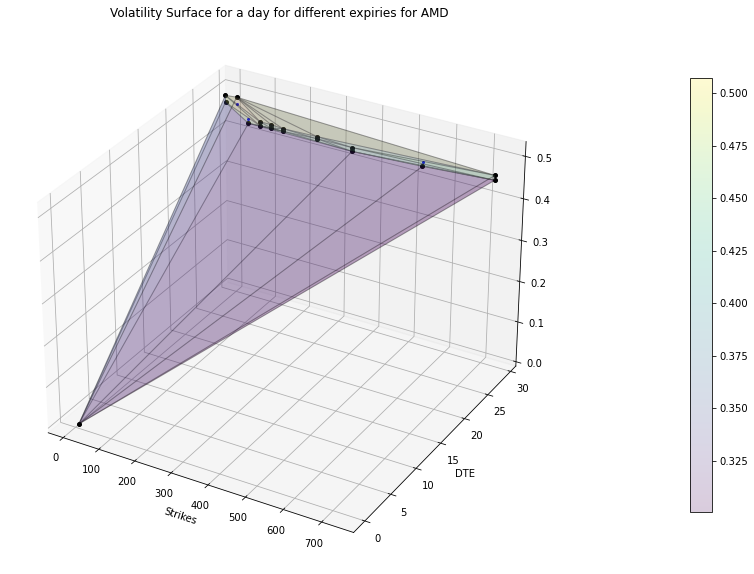

In [125]:
fig = plt.figure(figsize=(50,10))
ax = plt.axes(projection='3d')
points = np.column_stack((X, Y, Z))
hull = ConvexHull(points)
ax.plot(X, Y, Z, 'bo', ms=2)
ax.plot(points[hull.vertices, 0],
        points[hull.vertices, 1],
        points[hull.vertices, 2], 'ko', markersize=4)
s = ax.plot_trisurf(X, Y, Z, triangles=hull.simplices,
                    cmap='viridis', alpha=0.2, edgecolor='k')
plt.colorbar(s, shrink=.8)
plt.xlabel("Strikes")
plt.ylabel("DTE")
plt.title("Volatility Surface for a day for different expiries for AMD")
plt.show()

In [126]:
df.date=pd.to_datetime(df.date,format="%Y%m%d")
df.set_index('date',inplace=True)
call=df[df.cp_flag=="C"]
put=df[df.cp_flag=="P"]

ticker
ADI     AxesSubplot(0.125,0.2;0.775x0.68)
AMD     AxesSubplot(0.125,0.2;0.775x0.68)
AVGO    AxesSubplot(0.125,0.2;0.775x0.68)
INTC    AxesSubplot(0.125,0.2;0.775x0.68)
MCHP    AxesSubplot(0.125,0.2;0.775x0.68)
MPWR    AxesSubplot(0.125,0.2;0.775x0.68)
MU      AxesSubplot(0.125,0.2;0.775x0.68)
NVDA    AxesSubplot(0.125,0.2;0.775x0.68)
NXPI    AxesSubplot(0.125,0.2;0.775x0.68)
QCOM    AxesSubplot(0.125,0.2;0.775x0.68)
QRVO    AxesSubplot(0.125,0.2;0.775x0.68)
SWKS    AxesSubplot(0.125,0.2;0.775x0.68)
TXN     AxesSubplot(0.125,0.2;0.775x0.68)
Name: forward_price, dtype: object

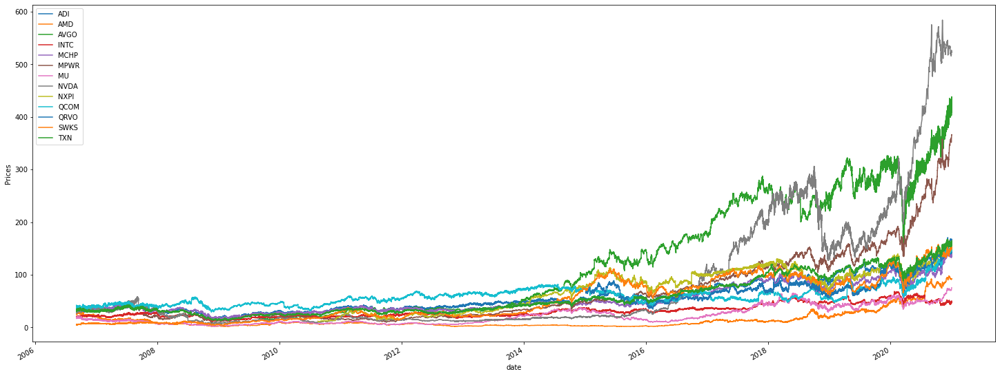

In [127]:
df.groupby('ticker').forward_price.plot(figsize=(25,10),legend=True,ylabel="Prices")

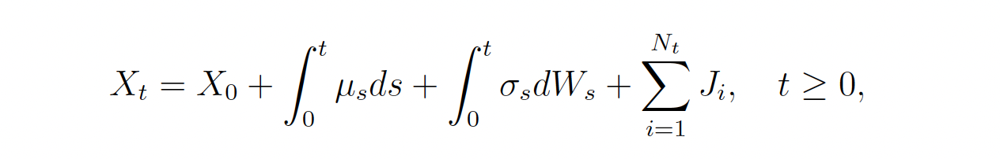

Assumptions - 

    1. Returns are lognormally distributed. 

    2. Underlying assets follow the aforementioned Brownian Motion Dynamics. 

    3. Volatility is asynchronous and exhibits decay in information retention through time series. 

    4. Volatility over time does not have autocorrelation. 

Extracting Forward Return Series from the data

In [8]:
def make_forwards(df,window):
    df=df[df.days==window]
    temp=df.groupby(['ticker','date']).forward_price.first().reset_index()
    futures=pd.DataFrame(index=df.index.unique())
    for i in df.ticker.unique():
        futures=futures.join(temp.groupby('ticker').get_group(i).set_index('date').forward_price.to_frame(i))
    return futures

In [9]:
forwards=make_forwards(df,30).fillna(0)
futures=forwards.copy()

In [10]:
window=30
for i in futures.columns.unique():
    futures[i+'SD']=futures[i].pct_change().rolling(window).std()*np.sqrt(252)
    futures[i+'1SD']=futures[i+'SD'].shift()
    for j in range(1,23):
         futures[i+str(j)+'SD']=futures[i+'1SD'].rolling(j).mean()

### HAR Model for Realized Volatility (Christensen et. al.)

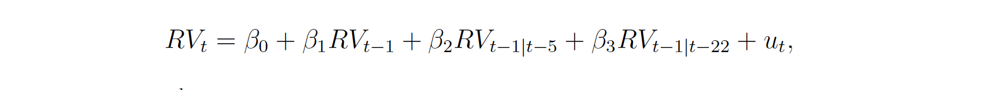

In [11]:
def multi_y_regression(Y,x,annual=1,model=False,year='2017'):
    fig, axes = plt.subplots(nrows=1, ncols=3,figsize=(40,10))
    res = []
    residual_mat=pd.DataFrame(index = Y.index)
    for col in Y.columns:
        y = Y[col]*annual
        X = sm.add_constant(x*annual)
        reg = sm.OLS(y[:year], X[:year],missing='drop').fit()
        residual_mat[col] = reg.resid
        reg_stats = reg.params.to_frame(col)
        reg_stats.loc['R^2',col] = reg.rsquared
        y_actual=y[year:]
        y_hat=reg.predict(sm.add_constant(x['2018':]))
        OOSR=1-(((y_hat-y_actual)**2).sum()/((y_actual-y_actual.mean())**2).sum())
        reg_stats.loc['OOS R^2',col]=OOSR
        reg_stats.loc['Regression Residual',col]=reg.resid.mean()
        reg_stats.loc['Durbin-Watson_Score',col]=statsmodels.stats.stattools.durbin_watson(reg.resid, axis=0)
        y_hat=y_hat.to_frame('Predicted Y')
        y_hat=y_hat.join(y_actual.to_frame('Actual Y'))
        y_hat.loc[:,'Errors']=y_hat['Predicted Y']-y_hat['Actual Y']
        y_hat.loc[:,'MSE']=y_hat.Errors.apply(lambda x:x**2)
        y_hat[y_hat.columns[:2]].plot(ax=axes[0],title=col[:len(col)-2]+" Predictions")
        y_hat.Errors.to_frame('Errors').plot(ax=axes[1],legend=True,title="Error Plot")  
        y_hat.MSE.to_frame('MSE').plot(ax=axes[2],legend=True,title="Squared Errors - Non Linear Scaling")  
        plt.xlabel("Predicted Y")
        plt.ylabel("Actual Y")
        res.append(reg_stats)
    res = pd.concat(res,axis=1).T
    MAE = res['const'].abs().mean()
    res=res.astype(float).round(4)
    res.loc[:,'MSE']=y_hat.MSE.sum()/y_actual.shape[0]
    res.columns=[['Alpha','1DAY','5DAY','22DAY','HAR_Insample R^2','HAR_OOS R^2','Residual','Durbin-Watson','MSE']]
    if model==False:
        return res
    else:
        return res,y_hat

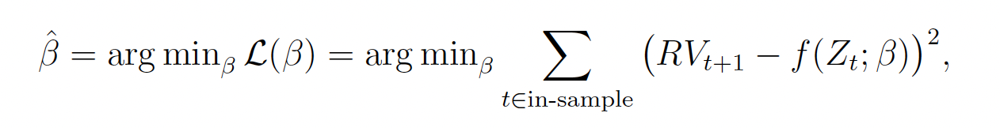

In [12]:
def HAR(forwards,futures,transformation="Linear"):
    har_dict={}
    if transformation=="Exponential":
        for a in forwards.columns.unique():
            if a==forwards.columns.unique()[0]:
                regres=multi_y_regression(futures.filter(regex=a+"SD").apply(lambda x:np.exp(x)),futures.filter(regex=a+'1SD|'+a+'5SD|'+a+'22SD').apply(lambda x:np.exp(x)),1,model=True)
                results=regres[0]
                har_dict[transformation+'_'+a]=regres[1]
            else:
                regres=multi_y_regression(futures.filter(regex=a+"SD").apply(lambda x:np.exp(x)),futures.filter(regex=a+'1SD|'+a+'5SD|'+a+'22SD').apply(lambda x:np.exp(x)),1,model=True)
                results=pd.concat([results,regres[0]],axis=0)
                har_dict[transformation+'_'+a]=regres[1]
        return results,har_dict
        
    if transformation=="Linear":
        for a in forwards.columns.unique():
            if a==forwards.columns.unique()[0]:
                regres=multi_y_regression(futures.filter(regex=a+"SD"),futures.filter(regex=a+'1SD|'+a+'5SD|'+a+'22SD'),1,model=True)
                results=regres[0]
                har_dict[transformation+'_'+a]=regres[1]
            else:
                regres=multi_y_regression(futures.filter(regex=a+"SD"),futures.filter(regex=a+'1SD|'+a+'5SD|'+a+'22SD'),1,model=True)
                results=pd.concat([results,regres[0]],axis=0)
                har_dict[transformation+'_'+a]=regres[1]
        return results,har_dict
    
    if transformation=="Non-Linear":
        for a in forwards.columns.unique():
            if a==forwards.columns.unique()[0]:
                regres=multi_y_regression(futures.filter(regex=a+"SD").apply(lambda x:x**2),futures.filter(regex=a+'1SD|'+a+'5SD|'+a+'22SD').apply(lambda x:x**2),1,model=True)
                results=regres[0]
                har_dict[transformation+'_'+a]=regres[1]
            else:
                regres=multi_y_regression(futures.filter(regex=a+"SD").apply(lambda x:x**2),futures.filter(regex=a+'1SD|'+a+'5SD|'+a+'22SD').apply(lambda x:x**2),1,model=True)
                results=pd.concat([results,regres[0]],axis=0)
                har_dict[transformation+'_'+a]=regres[1]
        return results,har_dict 


### Linear HAR Model for 13 Microchip Tickers

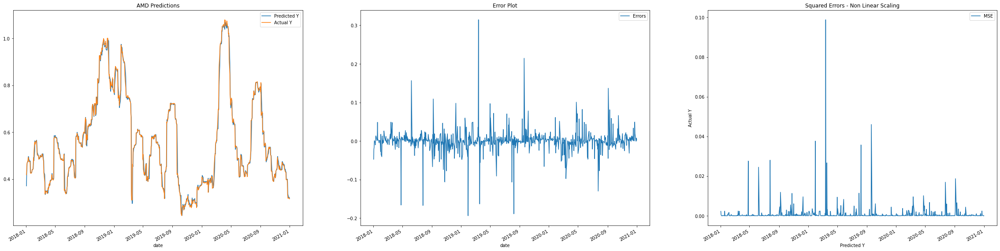

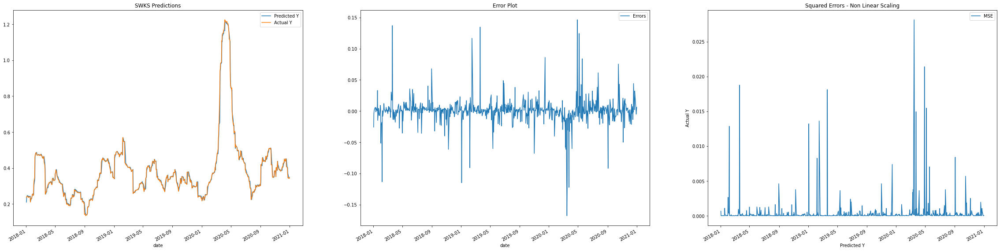

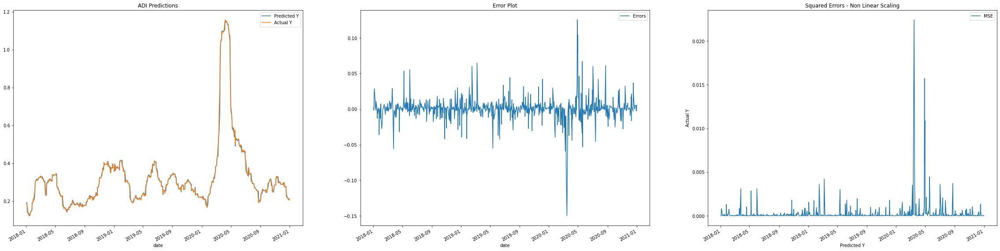

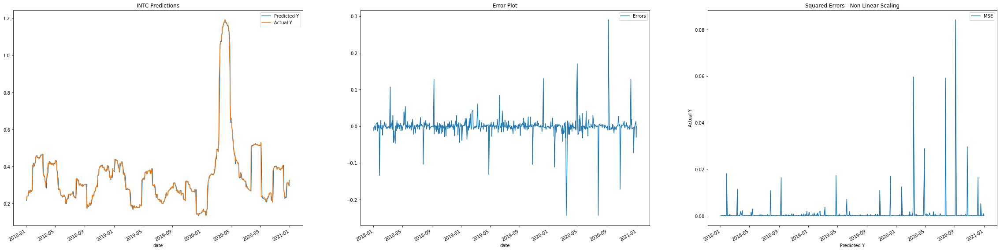

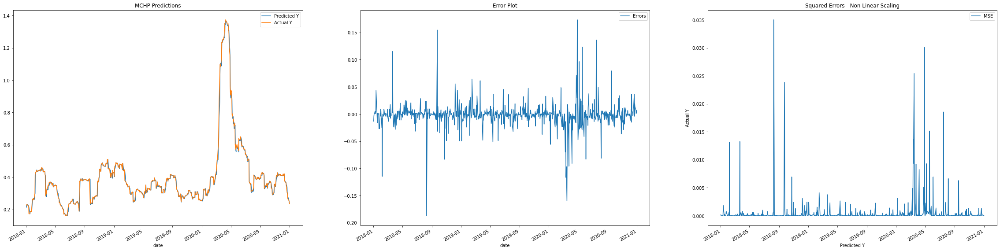

...

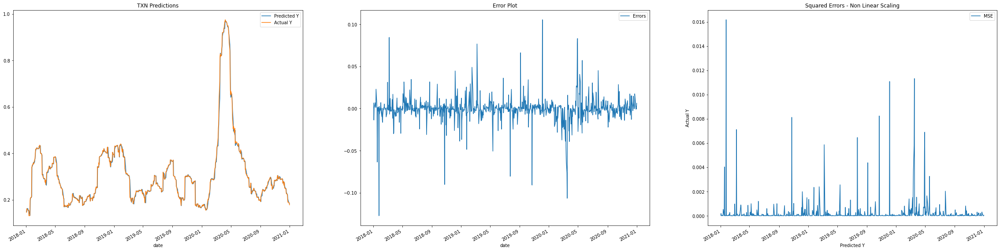

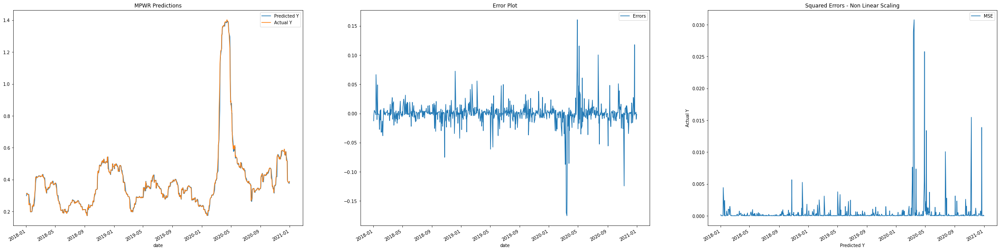

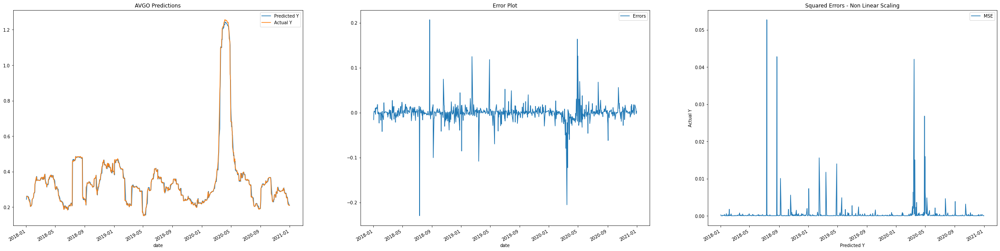

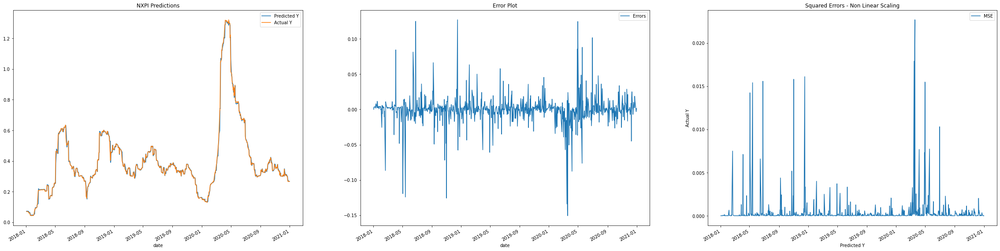

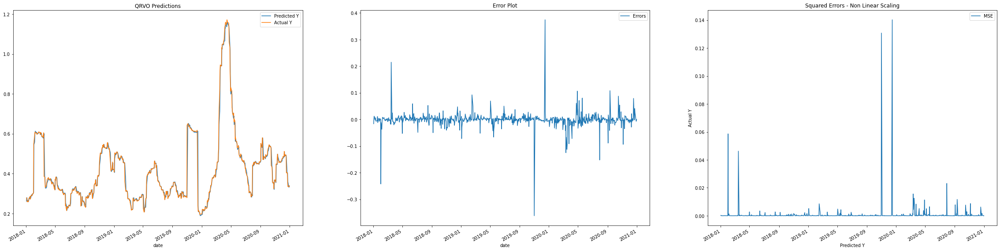

In [13]:
har1=HAR(forwards,futures,transformation="Linear")
har1_results=har1[0]
yhat_har1=har1[1]

### Non - Linear HAR Model for 13 Microchip Tickers

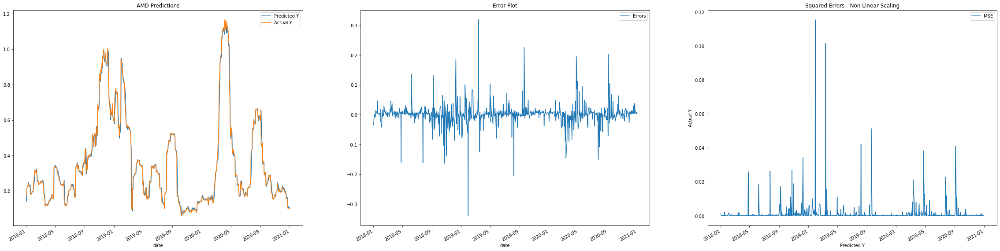

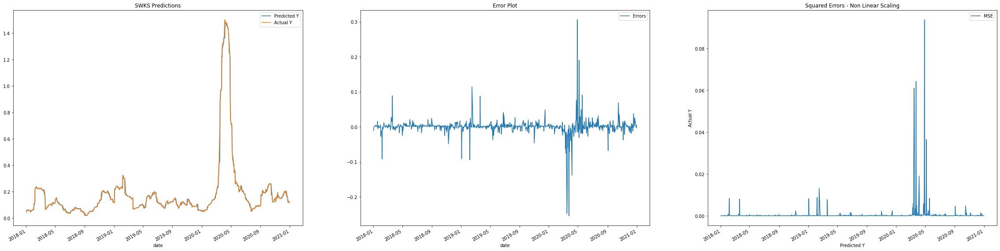

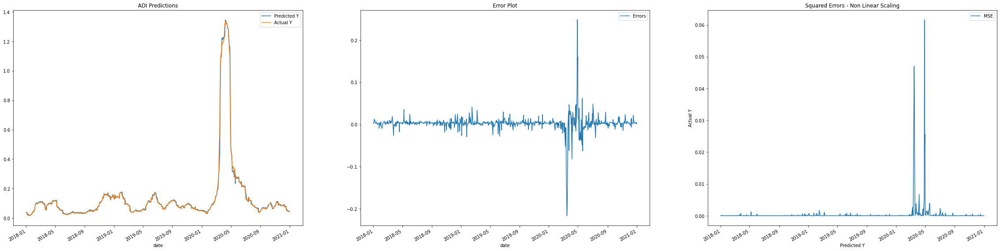

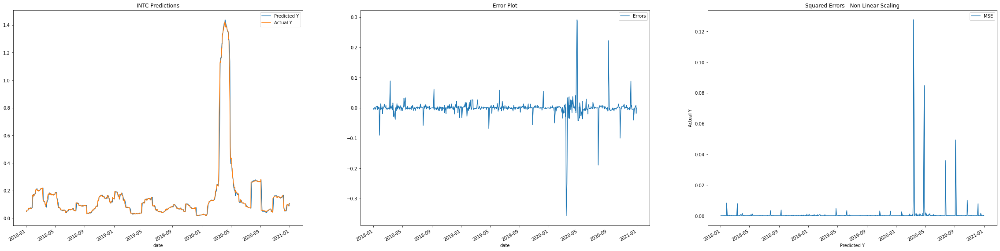

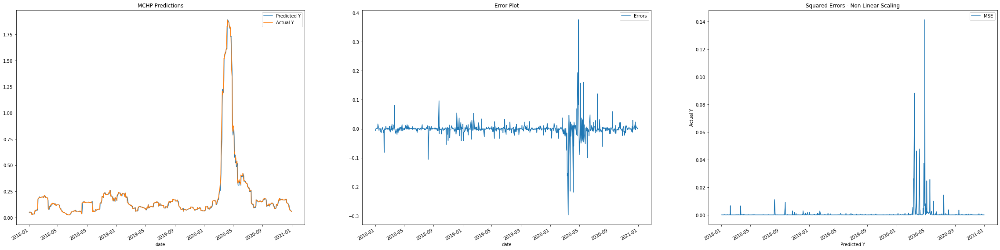

...

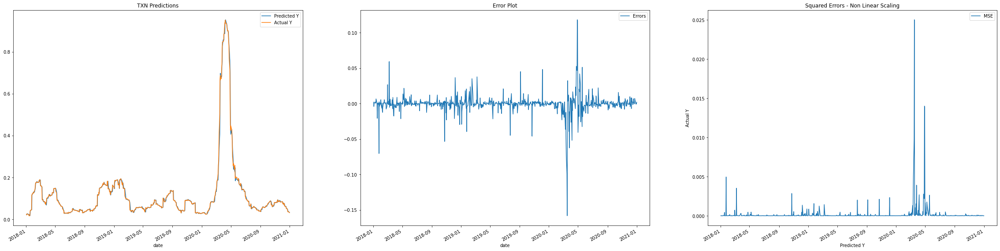

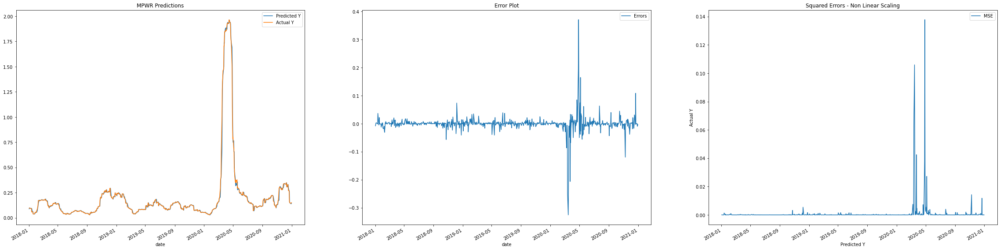

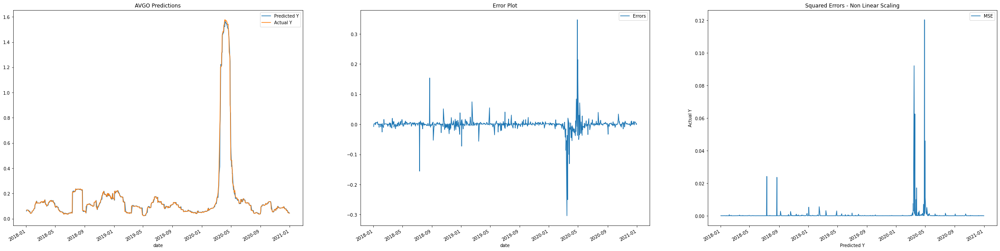

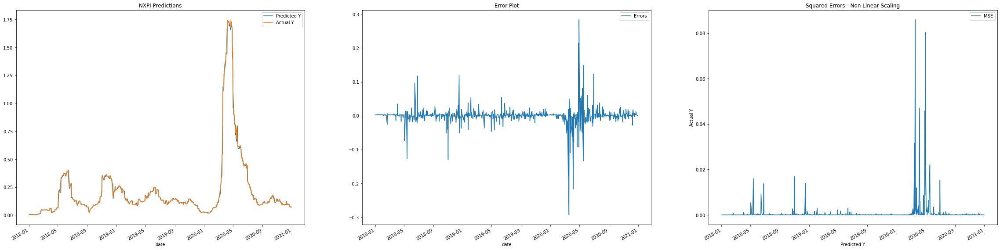

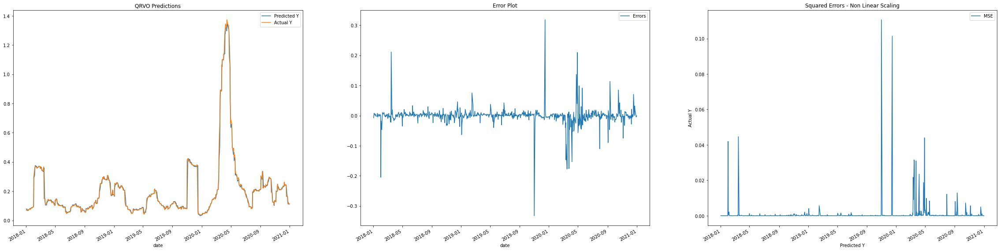

In [14]:
har2=HAR(forwards,futures,transformation="Non-Linear")
har2_results=har2[0]
yhat_har2=har2[1]

### Exponential HAR Model for 13 Microchip Tickers

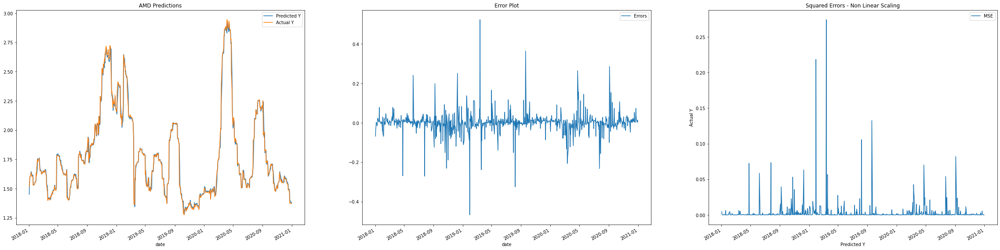

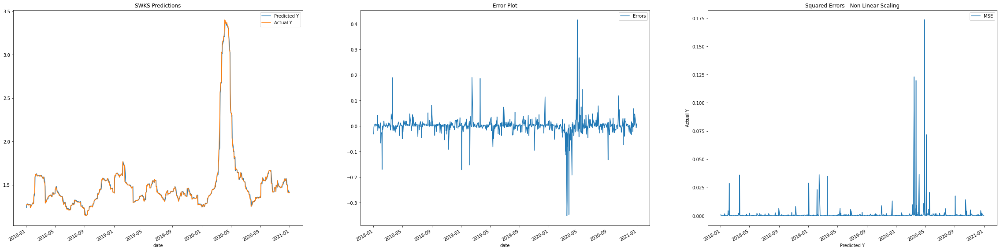

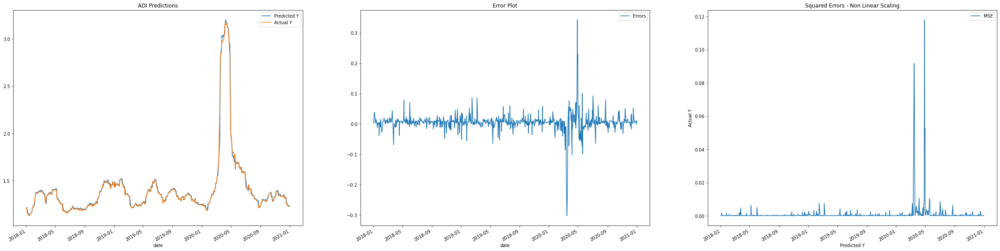

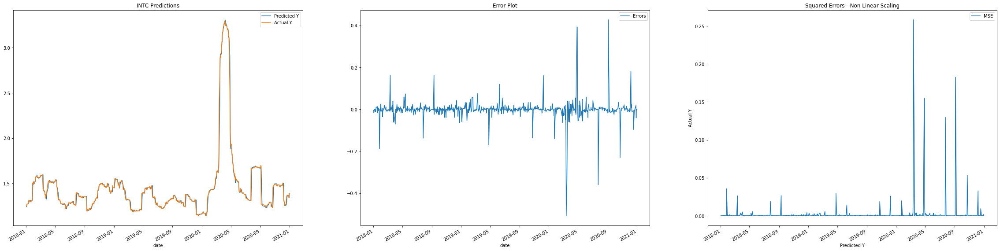

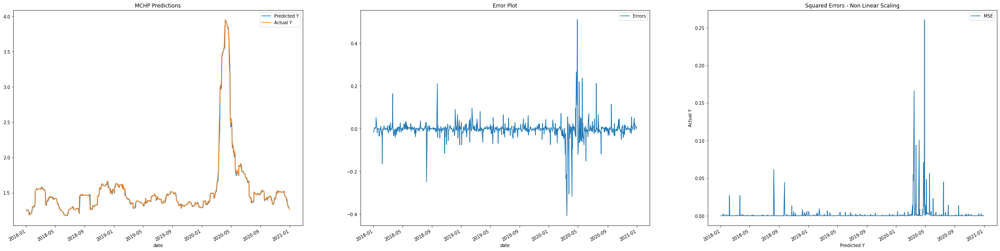

...

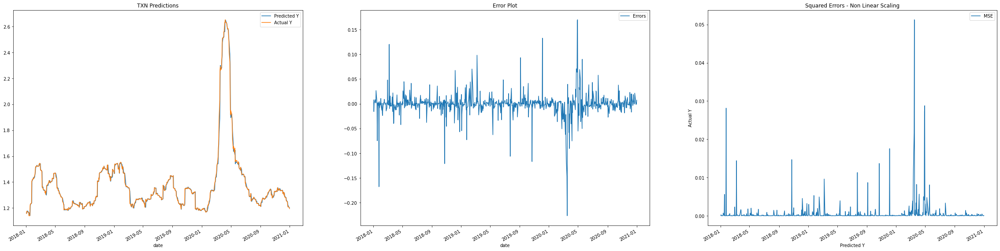

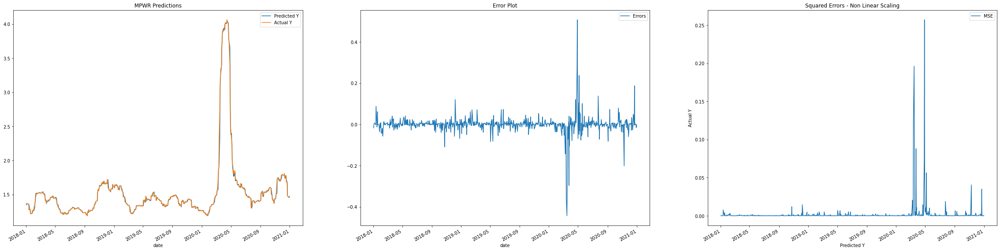

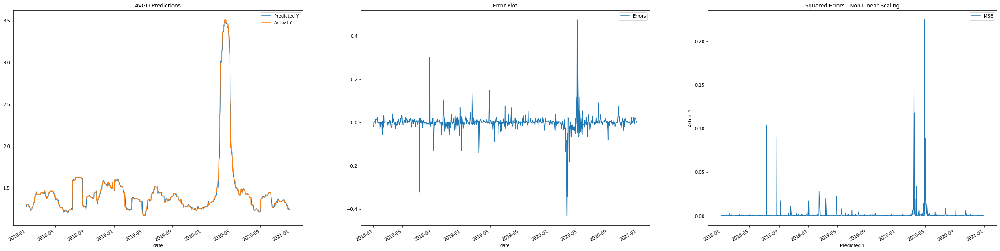

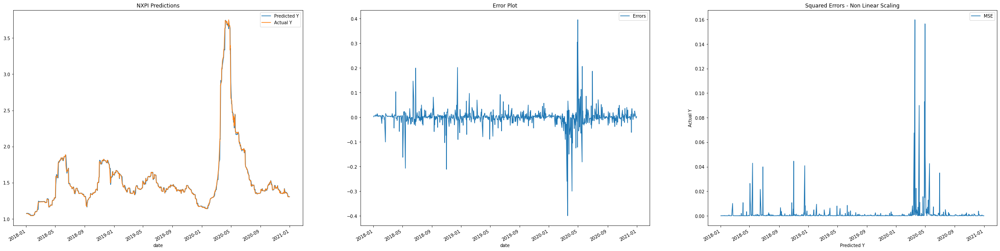

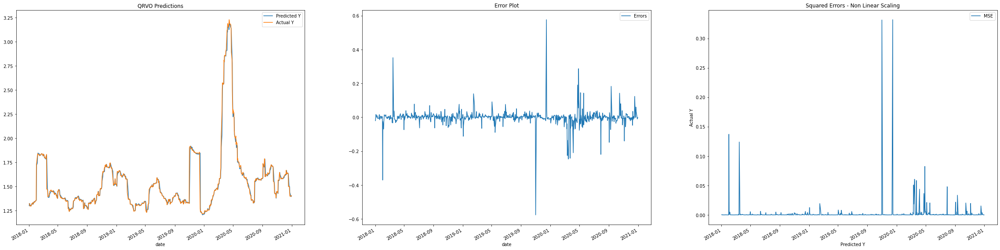

In [15]:
har3=HAR(forwards,futures,transformation="Exponential")
har3_results=har3[0]
yhat_har3=har3[1]

### HAR using Random Forests

Hyperparameter Tuning Roadmap (using a Heuristic Convex Optimization Function)

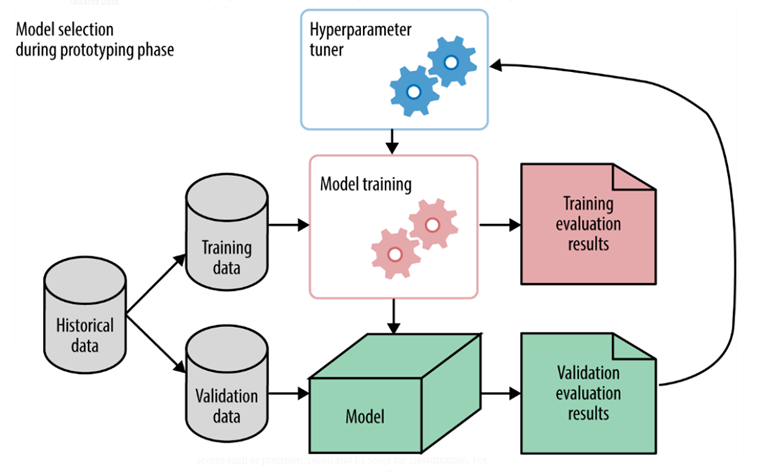

In [16]:
def objective(trial:Trial,train_y,train_x,test_x,test_y,extra=None):
    rf_n_estimators = trial.suggest_int('n_estimators', 1,100,step=2)
    rf_max_features = trial.suggest_categorical('max_features',['sqrt','log2'])
    rf_min_samples_leaf = trial.suggest_int('min_samples_leaf',5,240,step=10)
    rf_max_depth = trial.suggest_int('max_depth',4,15)
    rf_clf = RandomForestRegressor(n_estimators=rf_n_estimators,max_depth=rf_max_depth,min_samples_leaf=rf_min_samples_leaf,max_features=rf_max_features)
    rf_clf.fit(train_x,train_y)
    accuracy = rf_clf.score(test_x,test_y)
    return accuracy

In [17]:
def randomforest_feat_importances(m, df):   
    return pd.DataFrame({'cols':df.columns, 'feat_imp': m.feature_importances_}
                       ).sort_values('feat_imp', ascending=False)

### Random Forest Factor Construction

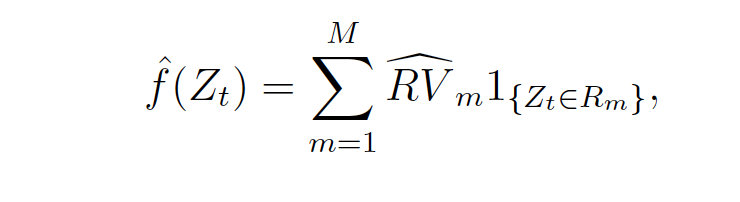

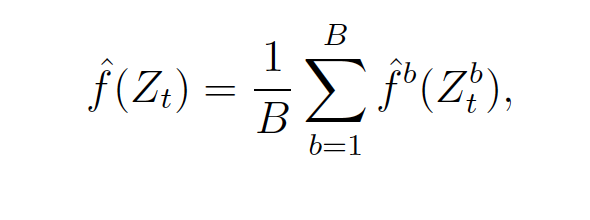

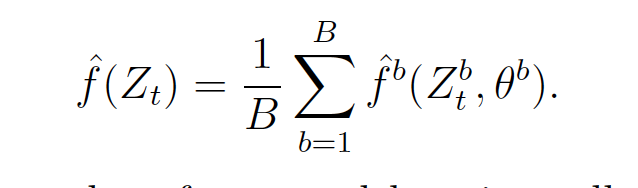

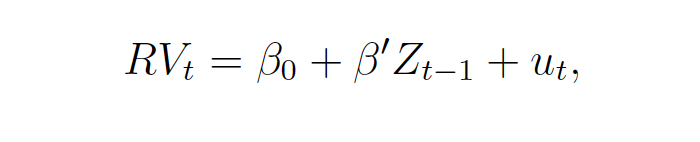

The variables from the aforementioned HAR model have been vectorized and regularized to be used for the purpose of Machine Learning based model training.

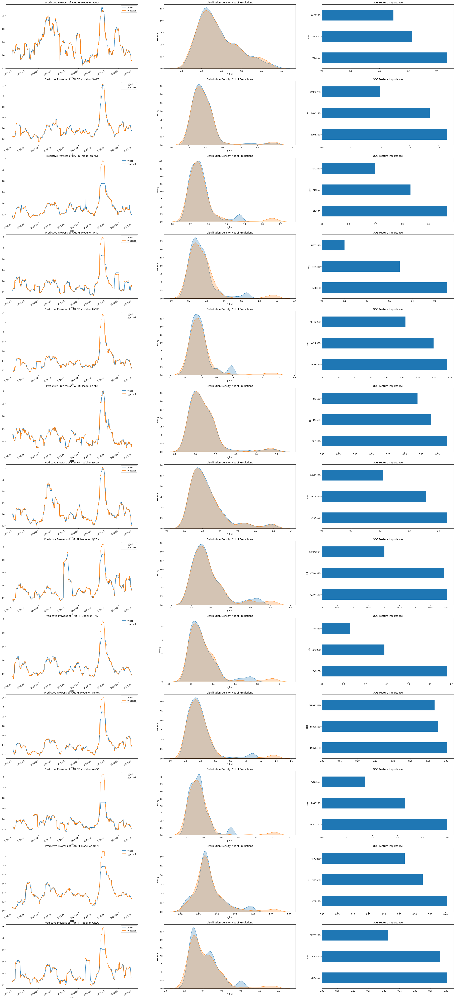

In [18]:
results=pd.DataFrame(index=forwards.columns.unique(),columns=["RF_Insample R^2","RF_OOS R^2"])
model_dict={}
fig, axes = plt.subplots(nrows=len(forwards.columns.unique()), ncols=3,figsize=(40,100))
for i in range(len(forwards.columns.unique())):
    a=forwards.columns.unique()[i]
    mlset_y=futures[a+"SD"]
    mlset_x=futures.filter(regex=a+'1SD|'+a+'5SD|'+a+'22SD').dropna()
    mlset_y=mlset_y[mlset_x.index.values[0]:]   
    training_y=mlset_y[:'2017'].dropna()
    training_x=mlset_x[:'2017'].dropna()
    testing_x=mlset_x['2018':].dropna()
    testing_y=mlset_y['2018':].dropna()
    training_y=training_y.filter(items=training_x.index.values,axis=0)
    training_x=training_x.filter(items=training_y.index.values,axis=0)
    direction="maximize"
    study = optuna.create_study(direction=direction)
    study.optimize(partial(objective,train_y=training_y,train_x=training_x,test_x=testing_x,test_y=testing_y), n_trials=500,n_jobs=-1)
    rf_clf = RandomForestRegressor(**study.best_params)
    rf_clf.fit(training_x,training_y)
    IR=rf_clf.score(testing_x,testing_y)
    OOSR=rf_clf.score(training_x,training_y)
    #Plotting 
    df=pd.Series(rf_clf.predict(testing_x),index=testing_x.index).to_frame('y_hat').join(testing_y)
    df=df.rename(columns={df.columns[1]:'y_actual'})
    #y_hat[y_hat.columns[:2]].plot(ax=axes[0],title=col[:len(col)-2]+" Predictions")
    df.plot(ax=axes[i,0],title="Predictive Prowess of HAR RF Model on "+a)
    sns.kdeplot(df.y_hat,shade=True,ax=axes[i,1],legend=True)
    sns.kdeplot(df[df.columns[1]],shade=True,ax=axes[i,1],legend=True).set(title="Distribution Density Plot of Predictions")
    fi = randomforest_feat_importances(rf_clf,training_x)
    fi.plot('cols', 'feat_imp', 'barh', legend=False,title="OOS Feature Importance",ax=axes[i,2])
    #Results
    results.loc[a,"RF_Insample R^2"]=IR
    results.loc[a,"RF_OOS R^2"]=OOSR
    model_dict[a]=df 
rf_models=model_dict
rf_results=results.copy()

### Smaller Subsection of a Random Forest at work for visualizing how it's functioning (Christensen et. al.)

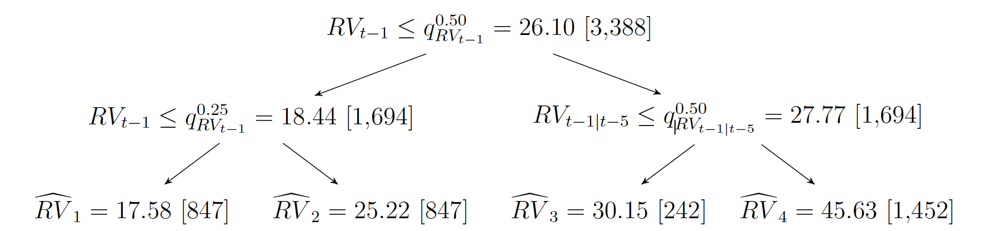

##### Results from Random Forest

In [19]:
rf_results

,RF_Insample R^2,RF_OOS R^2
AMD,0.96727,0.975019
SWKS,0.966673,0.979854
ADI,0.839546,0.861907
INTC,0.871007,0.988851
MCHP,0.771184,0.983676
MU,0.958401,0.963181
NVDA,0.97846,0.979728
QCOM,0.933715,0.980391
TXN,0.914178,0.983064
MPWR,0.916071,0.989289


## Realized Volatility Synchronization using Neural Network

#### Neural Network Definition & Architecture

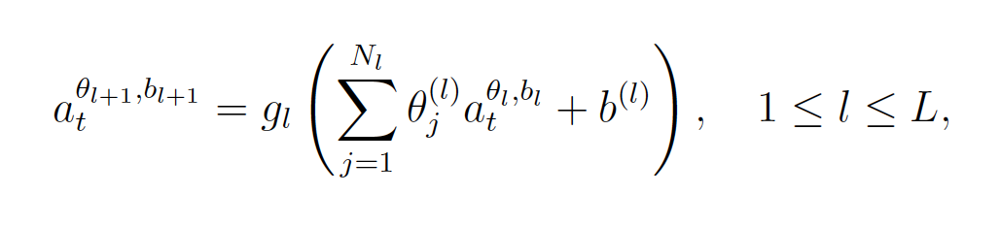

##### Vectorization Treatment for Neural Network training 

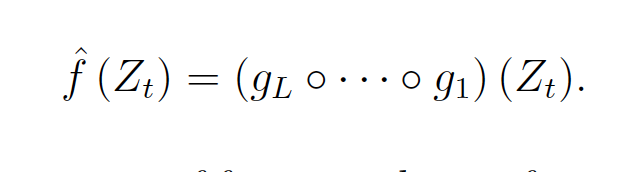

In [20]:

def build_model_custom(base=True,trial=None):
    try:
        n_layers = trial.suggest_int("n_layers", 1, 3)
        layers = []

        in_features = 20

        for i in range(n_layers):

            out_features = trial.suggest_int("n_units_l{}".format(i), 4, 18)

            layers.append(nn.Linear(in_features, out_features))
            layers.append(nn.LeakyReLU())

            in_features = out_features

        layers.append(nn.Linear(in_features, 2))
        layers.append(nn.LeakyReLU())

        return nn.Sequential(*layers)
    except:
        if base==True:
            return MLPRegressor(hidden_layer_sizes=(16,8,4),random_state=1, max_iter=500).fit(trial[0],trial[1])
        else:
            return MLPRegressor(hidden_layer_sizes=(8,4),random_state=1, max_iter=500).fit(trial[0],trial[1])

# Train and evaluate the accuracy of neural network with the addition of pruning mechanism
def train_and_evaluate(param=None, model=None, trial=None):
    
    df = pd.read_csv('Microchip.gz',compression='gzip')
    df = pd.get_dummies(df)
    
    train_data, val_data = train_test_split(df, test_size = 0.2, random_state = 42)
    train, val = train_data, val_data

    train_dataloader = torch.utils.data.DataLoader(train, batch_size=2, shuffle=True)
    val_dataloader = torch.utils.data.DataLoader(val, batch_size=2)

    use_cuda = torch.cuda.is_available()
    device = torch.device("cuda" if use_cuda else "cpu")

    criterion = nn.CrossEntropyLoss()
    optimizer = getattr(optim, param['optimizer'])(model.parameters(), lr= param['learning_rate'])
    if use_cuda:

            model = model.cuda()
            criterion = criterion.cuda()

    for epoch_num in range(EPOCHS):

            total_acc_train = 0
            total_loss_train = 0

            for train_input, train_label in train_dataloader:

                train_label = train_label.to(device)
                train_input = train_input.to(device)

                output = model(train_input.float())
                
                batch_loss = criterion(output, train_label.long())
                total_loss_train += batch_loss.item()
                
                acc = (output.argmax(dim=1) == train_label).sum().item()
                total_acc_train += acc

                model.zero_grad()
                batch_loss.backward()
                optimizer.step()
            
            total_acc_val = 0
            total_loss_val = 0

            with torch.no_grad():

                for val_input, val_label in val_dataloader:

                    val_label = val_label.to(device)
                    val_input = val_input.to(device)

                    output = model(val_input.float())

                    batch_loss = criterion(output, val_label.long())
                    total_loss_val += batch_loss.item()
                    
                    acc = (output.argmax(dim=1) == val_label).sum().item()
                    total_acc_val += acc
            
            accuracy = total_acc_val/len(val_data)
            
            # Add prune mechanism
            trial.report(accuracy, epoch_num)

            if trial.should_prune():
                raise optuna.exceptions.TrialPruned()

    return 
  
# Define a set of hyperparameter values, build the model, train the model, and evaluate the accuracy
def objective(trial):

     params = {
              'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),
              'optimizer': trial.suggest_categorical("optimizer", ["Adam", "RMSprop", "SGD"]),
              }
    
     model = build_model_custom(trial)
     accuracy = train_and_evaluate(params, model, trial)
     return accuracy

### Optimized Neural Network Structure for Volatility Modeling 

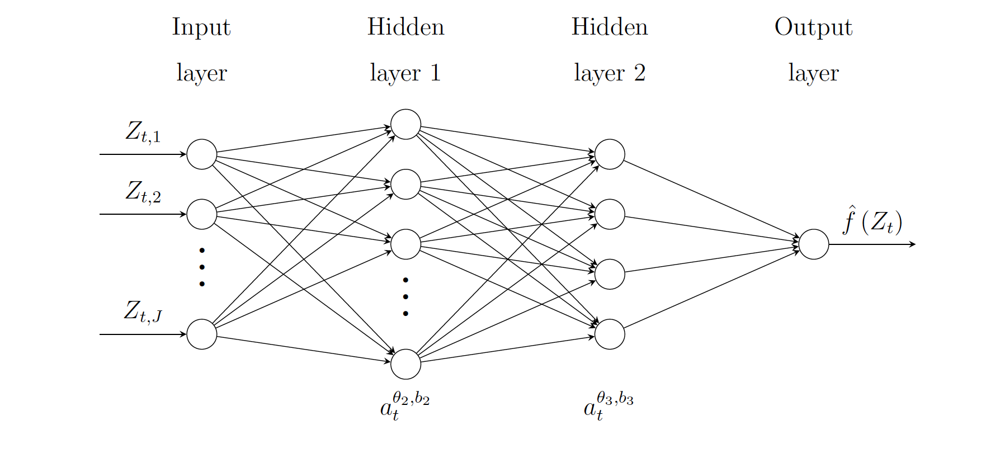

#### Implementation

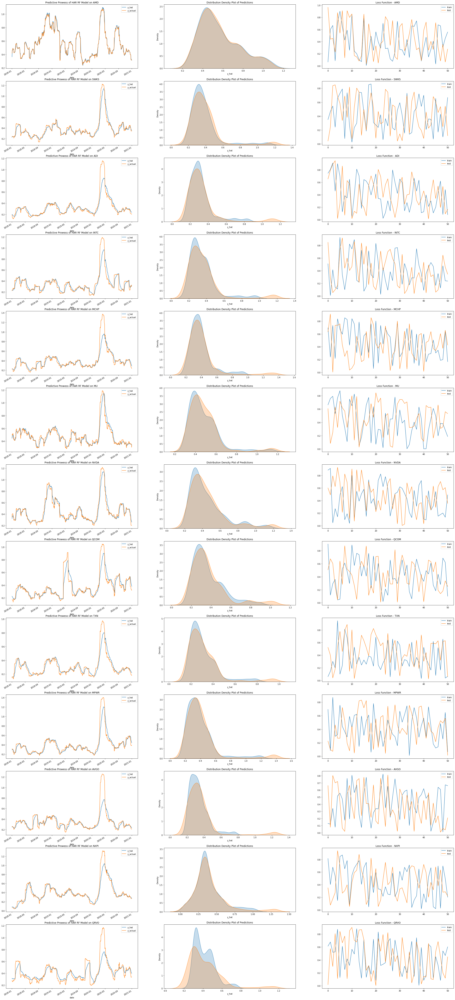

In [22]:
results=pd.DataFrame(index=forwards.columns.unique(),columns=["NN_Insample R^2","NN_OOS R^2"])
nn_models={}
fig, axes = plt.subplots(nrows=len(forwards.columns.unique()), ncols=3,figsize=(40,100))
for i in range(len(forwards.columns.unique())):
    a=forwards.columns.unique()[i]
    mlset_y=futures[a+"SD"]
    mlset_x=futures.filter(regex=a+'1SD|'+a+'5SD|'+a+'22SD').dropna()
    mlset_y=mlset_y[mlset_x.index.values[0]:]   
    training_y=mlset_y[:'2017'].dropna()
    training_x=mlset_x[:'2017'].dropna()
    testing_x=mlset_x['2018':].dropna()
    testing_y=mlset_y['2018':].dropna()
    training_y=training_y.filter(items=training_x.index.values,axis=0)
    training_x=training_x.filter(items=training_y.index.values,axis=0)
    model_base=build_model_custom(True,(training_x,training_y))
    isscore=model_base.score(training_x,training_y)
    oosscore=model_base.score(testing_x,testing_y)
    results.loc[a,"NN_Insample R^2"]=isscore
    results.loc[a,"NN_OOS R^2"]=oosscore
    df=pd.Series(model_base.predict(testing_x),index=testing_x.index).to_frame('y_hat').join(testing_y)
    df=df.rename(columns={df.columns[1]:'y_actual'})
    #y_hat[y_hat.columns[:2]].plot(ax=axes[0],title=col[:len(col)-2]+" Predictions")
    df.plot(ax=axes[i,0],title="Predictive Prowess of HAR RF Model on "+a)
    sns.kdeplot(df.y_hat,shade=True,ax=axes[i,1],legend=True)
    sns.kdeplot(df[df.columns[1]],shade=True,ax=axes[i,1],legend=True).set(title="Distribution Density Plot of Predictions")
    loss_function().plot(ax=axes[i,2],title="Loss Function - "+a)
    nn_models[a]=df
nn_results=results.copy()

### Results for Neural Network

In [133]:
nn_results

,NN_Insample R^2,NN_OOS R^2
AMD,0.964517,99.98
SWKS,0.938212,0.916896
ADI,0.770622,0.811203
INTC,0.933801,0.809551
MCHP,0.920692,0.792635
MU,0.93188,0.89311
NVDA,0.93859,0.931891
QCOM,0.915183,0.822677
TXN,0.925422,0.852459
MPWR,0.953233,0.861424


## Model Selection

##### Best Performing Models on Individual Tickers

In [24]:
rf=rf_results.iloc[:,2:]
nn=nn_results
x1=har1_results[har1_results.columns[4:6]]
x1.rename(columns={x1.columns[0][0]:'Linear_'+x1.columns[0][0],x1.columns[1][0]:'Linear_'+x1.columns[1][0]},inplace=True)
x1.index=rf.index
x2=har2_results[har2_results.columns[4:6]]
x2.rename(columns={x2.columns[0][0]:'Non-Linear_'+x2.columns[0][0],x2.columns[1][0]:'Non-Linear_'+x2.columns[1][0]},inplace=True)
x2.index=rf.index
x3=har3_results[har3_results.columns[4:6]]
x3.rename(columns={x3.columns[0][0]:'Exponential_'+x3.columns[0][0],x3.columns[1][0]:'Exponential_'+x3.columns[1][0]},inplace=True)
x3.index=rf.index
all_results=x1.join([x2,x3,rf,nn])
final_models=pd.Series(all_results.filter(regex="OOS").T.astype(float).idxmax()).apply(lambda x: str.replace(x[0],"_OOS R^2","") if isinstance(x,tuple) else str.replace(x,"_OOS R^2",""))

In [140]:
final_models

AMD                  NN
SWKS     Non-Linear_HAR
ADI          Linear_HAR
INTC     Non-Linear_HAR
MCHP     Non-Linear_HAR
MU       Non-Linear_HAR
NVDA                 RF
QCOM    Exponential_HAR
TXN                  NN
MPWR    Exponential_HAR
AVGO                 RF
NXPI         Linear_HAR
QRVO     Non-Linear_HAR
dtype: object

### Parabolic Optimization for Model Homogenity & Ensemble 

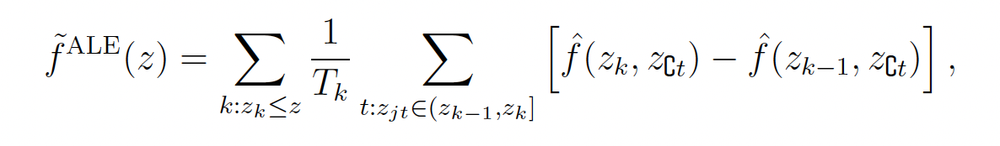

In [26]:
df_nn=pd.DataFrame(index=list(nn_models.values())[0].index,columns=final_models.index)
for i in list(nn_models.items()):
    df_nn.loc[:,i[0]]= i[1].y_hat
df_rf=pd.DataFrame(index=list(rf_models.values())[0].index,columns=final_models.index)
for i in list(rf_models.items()):
    df_rf.loc[:,i[0]]= i[1].y_hat  
df_lhar=pd.DataFrame(index=list(yhat_har1.values())[0].index)
for i in list(yhat_har1.items()):
    df_lhar.loc[:,i[0]]= i[1]['Predicted Y']
df_nlhar=pd.DataFrame(index=list(yhat_har2.values())[0].index)
for i in list(yhat_har2.items()):
    df_nlhar.loc[:,i[0]]= i[1]['Predicted Y']
df_ehar=pd.DataFrame(index=list(yhat_har3.values())[0].index)
for i in list(yhat_har3.items()):
    df_ehar.loc[:,i[0]]= i[1]['Predicted Y']
ale=df_nn.join(df_rf,lsuffix="_NN",rsuffix="_RF")
ale=ale.join([df_nlhar,df_ehar,df_lhar])
smooth_means=pd.DataFrame(index=ale.index,columns=final_models.index)
for i in final_models.index:
    smooth_means[i]=ale.filter(regex=i).mean(axis=1)

### Function for PDE transformation to generate homogenized unification of the ensemble of statistical & ML methods

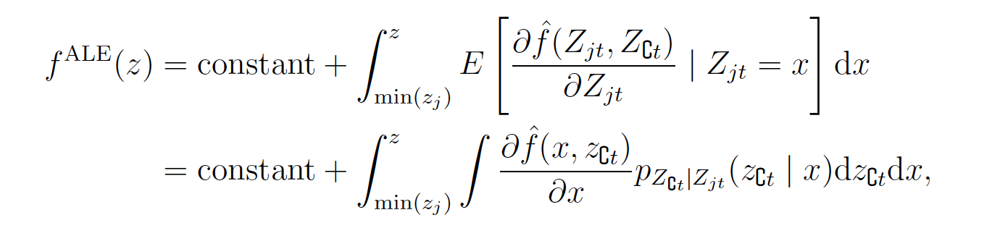

In [27]:
class ALE:
    def __init__(self,L=1,W=0.2,mu=1,rho=1,delta=0.2,gamma=0.4*0.2**2,beta=1.25,lambda_=1.25,g=0.4*0.2**2):
        L = 1
        W = 0.2
        mu = 1
        rho = 1
        delta = W/L
        gamma = 0.4*delta**2
        beta = 1.25
        lambda_ = beta
        g = gamma
        mesh = BoxMesh(Point(0, 0, 0), Point(L, W, W), 10, 3, 3)
        V = VectorFunctionSpace(mesh, 'P', 1)
        tol = 1E-14
    def clamped_boundary(self,x, on_boundary):
        

        bc = DirichletBC(V, Constant((0, 0, 0)), clamped_boundary)
        return on_boundary and x[0] < tol

    def epsilon(self,u):
        return 0.5*(nabla_grad(u) + nabla_grad(u).T)
        #return sym(nabla_grad(u))

    def sigma_ale(u,smooth=False):
        if smooth==True:
            return lambda_*nabla_div(u)*Identity(d) + 2*mu*epsilon(u)
        else:
            return u

    def ale(self,ale):
        u = TrialFunction(V)
        d = u.geometric_dimension()  # space dimension
        v = TestFunction(V)
        f = Constant((0, 0, -rho*g))
        T = Constant((0, 0, 0))
        a = inner(sigma(u), epsilon(v))*dx
        L = dot(f, v)*dx + dot(T, v)*ds

        # Compute solution
        u = Function(V)
        solve(a == L, u, bc)

        # Plot solution
        plot(u, title='Displacement', mode='displacement')

        # Plot stress
        s = sigma(u) - (1./3)*tr(sigma(u))*Identity(d)  # deviatoric stress
        von_Mises = sqrt(3./2*inner(s, s))
        V = FunctionSpace(mesh, 'P', 1)
        von_Mises = project(von_Mises, V)
        plot(von_Mises, title='Stress intensity')

        # Compute magnitude of displacement
        u_magnitude = sqrt(dot(u, u))
        u_magnitude = project(u_magnitude, V)
        plot(u_magnitude, 'Displacement magnitude')
        print('min/max u:',
              u_magnitude.vector().array().min(),
              u_magnitude.vector().array().max())

In [28]:
smooth_means=ALE.sigma_ale(smooth_means)

In [29]:
smooth_means.to_csv('Smooth_Means.csv')

### Smoothed Realized Volatilities 

<AxesSubplot:xlabel='Movement through Time', ylabel='ML Ensemble Smooth Volatility'>

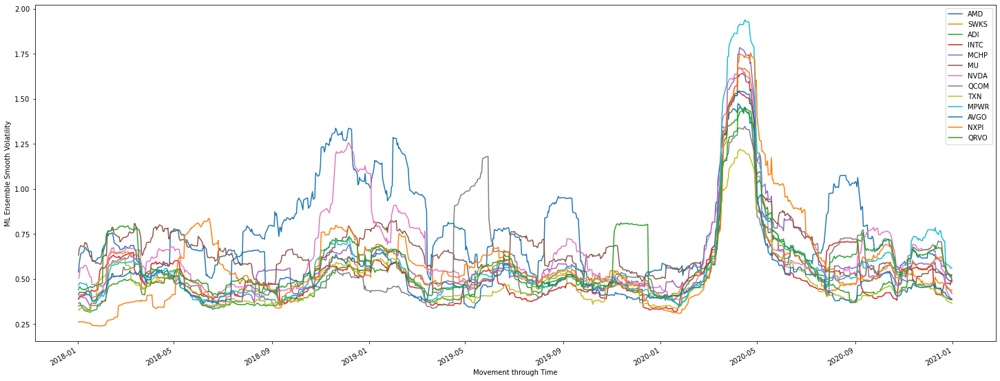

In [35]:
smooth_means.plot(figsize=(25,10),ylabel="ML Ensemble Smooth Volatility",xlabel="Movement through Time")

### Note - These volatilities will be used for constructing cones and trading

## Portfolio Variance

Constructing a equally weighted portfolio for the purpose of this draft. We will implement 3 portfolio weighting mechanisms - Equal weighted, Stratified and Weighted.

In [68]:
def portfolio_variance(dataframe,weighting="equal",n_assets=13,combine=False):
    if weighting=="equal" and combine==False:
        weights=np.array([round(1/n_assets,5) for i in range(n_assets)])
        return np.dot(weights.T,np.dot(dataframe.cov(),weights))
    elif combine==True:
        dataframe['Portfolio']=dataframe.apply(lambda x:(1/n_assets)*x).sum(axis=1)
        return dataframe
    else:
        weights=weighting
        return np.dot(weights.T,np.dot(dataframe.cov(),weights))

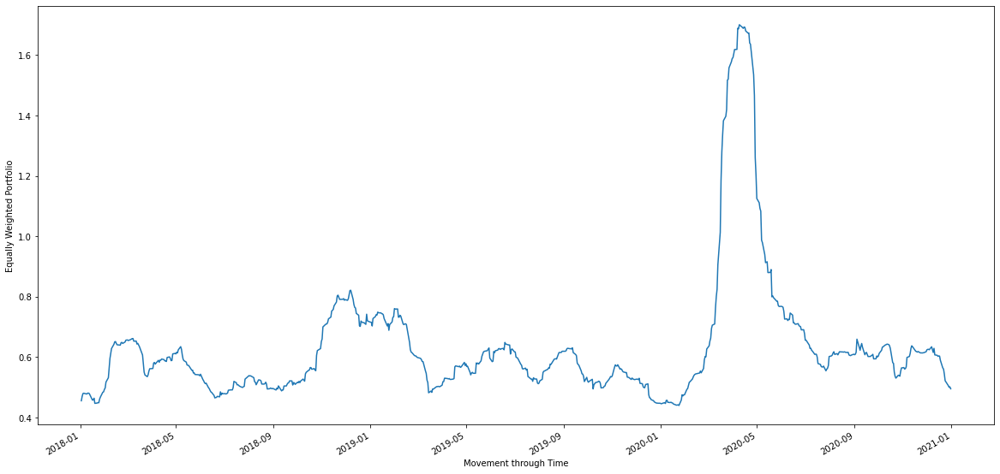

In [118]:
pf=portfolio_variance(smooth_means,combine=True)
pf.Portfolio.plot(figsize=(20,10),ylabel="Equally Weighted Portfolio",xlabel="Movement through Time")
pf=pf.resample('M').asfreq()

#### Realized Volatility Breakdown 

In [144]:
rr(portfolio_variance(smooth_means,combine=True))

,mean,std,Sharpe,Minimum,Maximum,Median,Skewness,Excess Kurtosis,5 %ile,10 %ile,90 %ile,95 %ile,Expected Value 5 %ile,Expected Value 10 %ile,Expected Value 90 %ile,Expected Value 95 %ile
AMD,0.768602,0.240237,3.199344,0.415100,1.472953,0.694039,1.038230,0.408703,0.483262,0.519665,1.130997,1.288761,0.460713,0.481199,0.709372,0.736286
SWKS,0.567897,0.223414,2.541904,0.338022,1.673208,0.516003,3.337794,12.272556,0.391540,0.411629,0.672845,0.917629,0.371816,0.387605,0.510376,0.522647
ADI,0.502496,0.199669,2.516648,0.314767,1.454416,0.459837,3.292511,11.614928,0.352589,0.362359,0.641429,0.798834,0.337664,0.347363,0.448796,0.462327
INTC,0.529447,0.213252,2.482731,0.320362,1.541347,0.472582,3.234106,11.594013,0.354634,0.376554,0.674452,0.825950,0.338781,0.352046,0.474554,0.487077
MCHP,0.582483,0.241949,2.407460,0.343257,1.784509,0.528956,3.251538,11.483103,0.396827,0.418574,0.762144,1.016118,0.369419,0.388519,0.516836,0.533927
MU,0.673154,0.201227,3.345238,0.457709,1.641258,0.626372,2.877044,9.808981,0.491643,0.517940,0.806694,0.966724,0.477937,0.491952,0.621910,0.634508
NVDA,0.645764,0.255169,2.530732,0.384388,1.671717,0.560752,2.209884,5.160063,0.429029,0.444440,0.891313,1.205624,0.405732,0.420730,0.574330,0.600973
QCOM,0.552850,0.205235,2.693746,0.323623,1.345274,0.497283,2.093112,4.463791,0.357561,0.375367,0.735666,1.041498,0.349026,0.358511,0.495178,0.517020
TXN,0.486088,0.160575,3.027173,0.314943,1.219709,0.446760,2.752082,8.607422,0.353165,0.365747,0.606595,0.799847,0.342525,0.350397,0.444138,0.455082
MPWR,0.583489,0.275238,2.119944,0.354186,1.938183,0.520561,3.496336,13.111528,0.378457,0.397529,0.725984,0.945214,0.370617,0.378654,0.513156,0.527226


Text(0, 0.5, 'Movement through time')

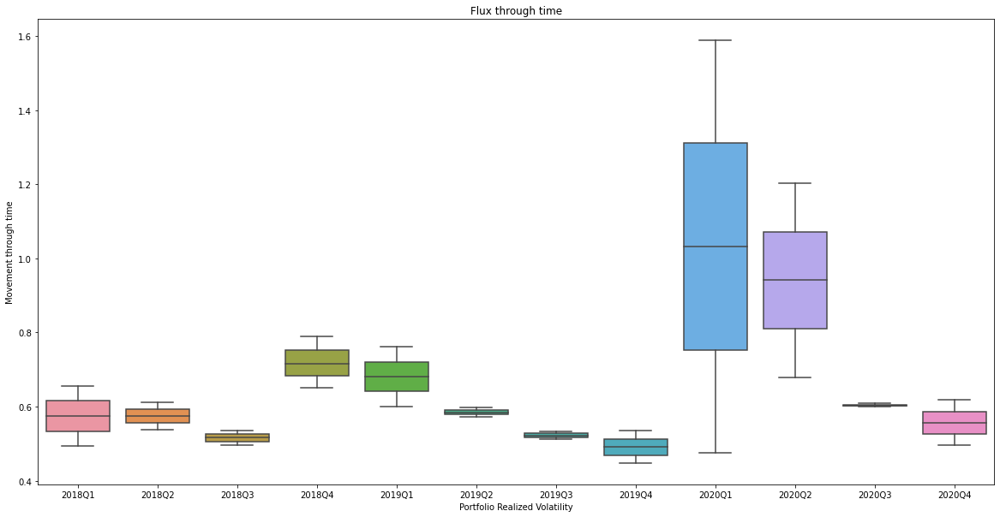

In [141]:
fig,axes=plt.subplots(figsize=(20,10))
sns.boxplot(y=pf.Portfolio,x=pd.to_datetime(pf.index).to_period('Q'))
plt.title('Flux through time')
plt.xlabel('Portfolio Realized Volatility')
plt.ylabel('Movement through time')

We are now ready to construct our volatility cones using our realized volatility time series. This dataset was made using an Ensemble of Statistical & Machine Learning models and homogenized using ALE. Proof 





## Volatility Cones

In [1]:
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [30, 10]

import pandas as pd
import numpy as np
import scipy as sp
import quandl
import pickle
from itertools import product
import functools
import seaborn as sns
from plotnine import *
from plotnine.data import *
from datetime import datetime, timedelta
from sklearn.linear_model import LinearRegression

def plot_histogram(df, var, title): 
    plot = (ggplot(data = df, 
               mapping = aes(x = var)) +
             geom_histogram(colour = "black", fill = "white") +
     # 25% quantile
      geom_vline(aes(xintercept=df[var].quantile(.25)),
                color="blue", linetype="dashed", size=1) +
     # median
     geom_vline(aes(xintercept=df[var].quantile(.5)),
                color="blue", linetype="dashed", size=1)+
     # mean
     geom_vline(aes(xintercept=df[var].mean()),
                color="red", linetype="dashed", size=1)+
      # 75% quantile
      geom_vline(aes(xintercept=df[var].quantile(.75)),
                color="blue", linetype="dashed", size=1) +
     theme(element_text(angle = 90, vjust = 0.5, hjust=1)) +
     ggtitle(title)
    )
    
    print(plot)

# Volatility Cones

Volatility cones as first described in Burghart and Lane (1990) have two main benefits:

 - 1) *Placing implied volatility into context* : Trading volatility is inherently an uncertain enterprise since, unlike equities for example, there is no link to fundamental indicators like a firm's cash flows, earnings, etc. Instead, an asset's historical volatility is typically the best tool a quantitative trader might have to assess their IV forecast. Volatility cones provide a way for contextualizing volatility analysis, "The purpose of a volatility cone is to illustrate the ranges of volatility experience for different trading horizons." (p. 73 of Burghart and Lane (1990))
 
 
 - 2) *Signal generation/filtration*: By comparing an IV to the volatility's historical distribution, we are able to know if the volatility is above or beyond certain historical bounds. Burghart and Lane (1990) gives the example of Eurodollar options. They explain that those derivative contracts had an IV that was above the historic upper bound, as a result, we should have strong reason to believe that volatility would fall within the bounds. This is exactly what happened in the following weeks and being short the contracts was a profitable opportunity. Volatility cones therefore allow us to filter out any forecast we might have of IV or it can also act as a signal generator on its own since we can compare spot IV with the distribution outlined by the cone.
 
 Volatility cones can be calculated in several ways. This strategy employs the following method. We first begin by getting a few years worth of the underlying's fitted M-day historical volatilities from our predictive models.  We then can create non-overlapping windows of 10 trading days. For each window, we assign their decile (rank). We then calculate an exponentially weighted mean by rank -- putting more weight on more recent windows. Weights are created as follows:

$$
w_{i}= \begin{cases}\alpha(1-\alpha)^{i} & \text { if } i<t \\ (1-\alpha)^{i} & \text { if } i=t\end{cases}
$$

where $\alpha$ is the smoothing factor.

For each historical time period, we therefore have a volatility distribution -- in our case we have chosen the 1 to 10th decile.

# Trading Strategy

Once we have our volatility cones, our trading strategy becomes clear. On a daily basis, we examine the implied volatility of a particuliar option with M-days to expiry. We compare it to the historical realized volatility outlined by the volatility cone that we constructed. We then estimate an M-day realized volatility of the following day. We also compare this volatility forecast with the distribution outlined by the volatility cone. If the IV of the option is above/below a chosen boundary of the volatility cone and the next day realized volatility forecast is within the boundaries, we short/go long the option. 

Therefore our profit can be approximated by  
$$P/L = k*vega*(\sigma - \sigma_{implied}) \;\;\;\;\;\;\; (1)$$
where $vega$ is the how the option price changes with respect to the underlying's IV (formerly $\frac{\partial C}{\partial \sigma}$). $\sigma_{implied}$ is the volatility value required to be put in the well-known Black-Scholes options pricing equation in order to generate the observed price of the contract. Furthermore, if we hold the contracts till expiration and realized volatility amounts to $\sigma$ on average, we will  make $(1)$. This strategy will yield a positive PnL under two scenarios:

- 1) Total notional ($k * vega$) < 0 and $\sigma - \sigma_{implied} < 0$ (Shorted the option and volatility fell). 
- 2) Total notional ($k * vega$) > 0 and $\sigma - \sigma_{implied} > 0$ (Went long the option and volatility rose).

We consider this strategy for each of our thirteen microchip options and their respective underlyings (futures).






# Illustrative Example

For illustrative purposes, we show the construction of the volatility cones of the Invesco S&P 500 Eql Wght Energy ETF. We omit the step where we produce the fitted values from a predictive algorithm and instead simply use the one-day percent returns to generate the historical volatilities we input into the cone algorithm.

In [2]:
# Grab more data early to prevent NAs when calculating returns later
quandl.ApiConfig.api_key = 'jJeFoAcYubSY8xDcp3oy'
RYE = quandl.get_table('QUOTEMEDIA/PRICES', \
                       date = [d.strftime('%Y-%m-%d')\
                               for d in pd.date_range('20150101','20211130')], \
                       ticker='RYE')

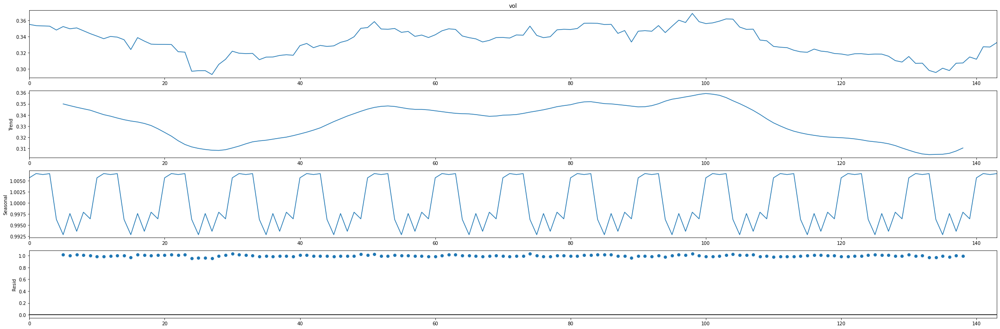

In [78]:
from random import randrange
from pandas import Series
from matplotlib import pyplot
day_of_interest = "2021-11-23"
df = RYE.loc[:day_of_interest].copy()
df["return"] = df["adj_close"] / df["adj_close"].shift(1) - 1

df["vol"] = df["return"].rolling(i).std() * np.sqrt(252)
# df = df.reset_index()
df = df.dropna()
df = df.sort_values("date")
df = df.reset_index()
from statsmodels.tsa.seasonal import seasonal_decompose
series = df["vol"]
result = seasonal_decompose(series, model='multiplicative', period=10)
result.plot()
pyplot.show()

### Exponential weighting

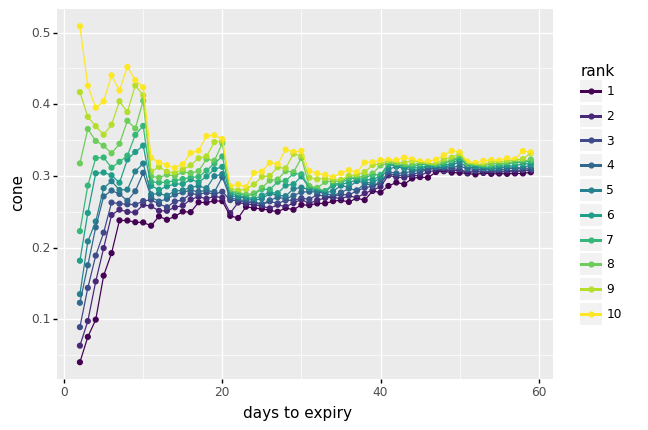

<ggplot: (337951946)>

In [62]:
w = "exp"
cones = []
for i in range(1, 60):
    day_of_interest = "2021-11-23"
    df = RYE.loc[:day_of_interest].copy()
    df["return"] = df["adj_close"] / df["adj_close"].shift(1) - 1
    df["vol"] = df["return"].rolling(i).std() * np.sqrt(252)
    df = df.reset_index()
    df = df.dropna()
    df = df.sort_values("date")
    df = df.groupby(df.index // 10).filter(lambda x: len(x) == 10).copy()
    df["rank"] = df.groupby(df.index // 10)["vol"].transform(pd.qcut,10, range(1, 11))
    # mean table / should try add exponential weighting 
    
    if w == "exp":
        df = pd.DataFrame({"cone" : df.sort_values(["rank", "date"], ascending = False).groupby("rank")["vol"].apply(lambda x: \
                                                       np.average(x, \
           weights = np.concatenate(([1-.05], [0.05 * (1-.05) ** j for j in range(1, len(x)) ]))))})
    elif w == "mean":
        df = pd.DataFrame({"cone" : df.groupby("rank")["vol"].mean()})
    df = df.reset_index(drop = False)
    df["days to expiry"] = i
    
    cones.append(df)

(ggplot(data = pd.concat(cones), mapping= aes(x = "days to expiry", y = "cone", color = "rank")) +
geom_point() +
geom_line())

### Equal weighting

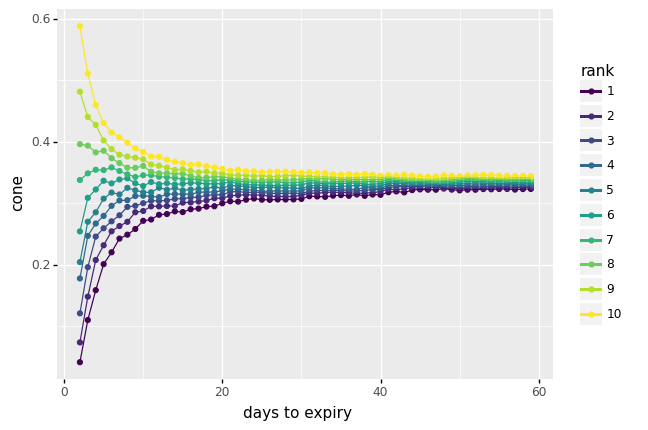

<ggplot: (336765537)>

In [61]:
w = "mean"
cones = []
for i in range(1, 60):
    day_of_interest = "2021-11-23"
    df = RYE.loc[:day_of_interest].copy()
    df["return"] = df["adj_close"] / df["adj_close"].shift(1) - 1
    df["vol"] = df["return"].rolling(i).std() * np.sqrt(252)
    df = df.reset_index()
    df = df.dropna()
    df = df.sort_values("date")
    df = df.groupby(df.index // 10).filter(lambda x: len(x) == 10).copy()
    df["rank"] = df.groupby(df.index // 10)["vol"].transform(pd.qcut,10, range(1, 11))
    # mean table / should try add exponential weighting 
    
    if w == "exp":
        df = pd.DataFrame({"cone" : df.sort_values(["rank", "date"], ascending = False).groupby("rank")["vol"].apply(lambda x: \
                                                       np.average(x, \
           weights = np.concatenate(([1-.05], [0.05 * (1-.05) ** i for i in range(1, len(x)) ]))))})
    elif w == "mean":
        df = pd.DataFrame({"cone" : df.groupby("rank")["vol"].mean()})
    df = df.reset_index(drop = False)
    df["days to expiry"] = i
    
    cones.append(df)

(ggplot(data = pd.concat(cones), mapping= aes(x = "days to expiry", y = "cone", color = "rank")) +
geom_point() +
geom_line())